<a href="https://colab.research.google.com/github/izaskunsas/izaskunthesis2025/blob/main/Clusters_FINAL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#***CLUSTERING ANALYSIS***
## **SETTING THE SESSION**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import os
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import umap
from sklearn.model_selection import train_test_split

from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.cluster import FeatureAgglomeration

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.metrics import normalized_mutual_info_score
from sklearn.metrics import silhouette_samples

from sklearn.feature_selection import f_classif
from sklearn.feature_selection import mutual_info_classif

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/THESIS/Code/data/data_FINAL", index_col=0)

In [ ]:
data = data[~data['league'].isin(['ukraine_league', 'finland_league', 'czechia_league', 'greece_league'])]

In [ ]:
os.makedirs('/content/drive/MyDrive/THESIS/Code/plots/Clustering/', exist_ok=True)

def purity_score(y_true, y_pred):
    contingency_matrix = pd.crosstab(y_pred, y_true)
    return np.sum(np.amax(contingency_matrix.values, axis=1)) / np.sum(contingency_matrix.values)

In [ ]:
#SPLIT - Splitting by year and i'm not removing temporal componetns because
train_years = ['FIFA 15', 'FIFA 16', 'FIFA 17', 'FIFA 18', 'FIFA 19', 'FIFA 20', 'FIFA 21']
data_trainval = data[data['Year'].isin(train_years)]

val_years   = ['FIFA 22', 'FIFA 23']
data_val = data[data['Year'].isin(val_years)]

test_years  = ['FC 24', 'FC 25']
data_test = data[data['Year'].isin(test_years)]

#SEPARATE OUTPUT VARIABLE
X_trainval = data_trainval.drop(columns=['league', 'Year', 'name', 'team', 'nation', 'position'])
y_trainval = data_trainval['league']

X_val = data_val.drop(columns=['league', 'Year', 'name', 'team', 'nation', 'position'])
y_val = data_val['league']

X_test = data_test.drop(columns=['league', 'Year', 'name', 'team', 'nation', 'position'])
y_test = data_test['league']

#TRAIN SPLIT -- for hyperparameter tuning into train and validation, stratified by league so they are more or less equal in the tuning of the model
X_train, X_val_strat, y_train, y_val_strat = train_test_split(
    X_trainval,
    y_trainval,
    test_size=0.2,  # 20% for validation
    random_state=22,
    stratify=y_trainval
)

##**1. KMEANS ANALYSIS - ALL LEAGUES**



K     Silhouette  ARI       
5     0.214       0.003     
6     0.206       0.003     
8     0.182       0.003     
12    0.165       0.004     
16    0.157       0.003     
20    0.149       0.004     
26    0.140       0.003     


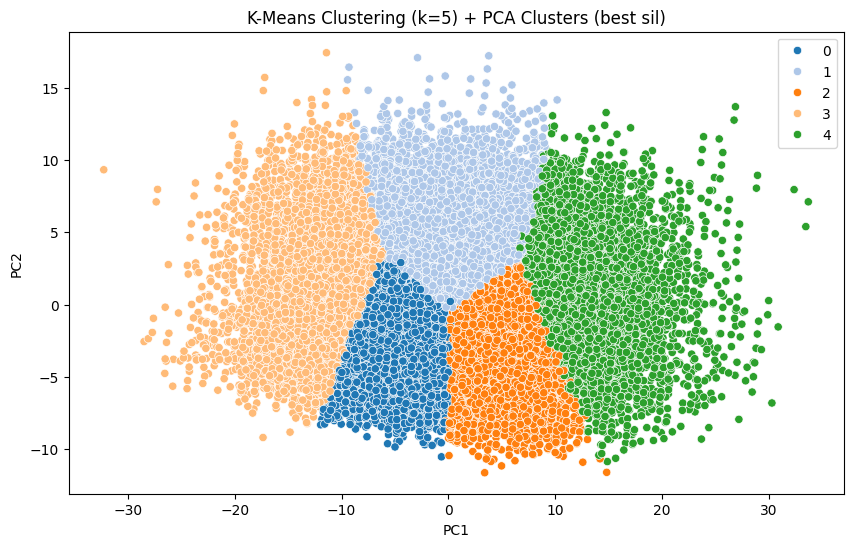

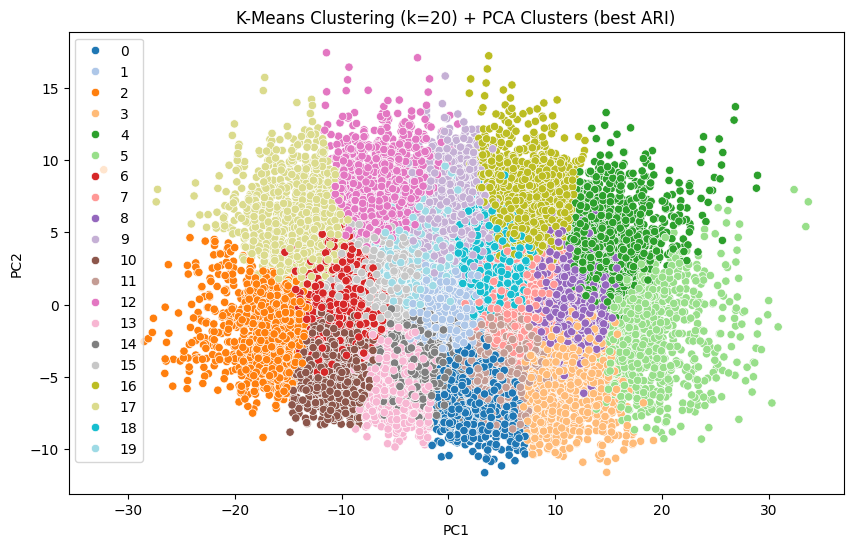

In [ ]:
k_values = [5, 6, 8, 12, 16, 20, 26] #from literature
results = []

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=22, n_init='auto')
    labels = kmeans.fit_predict(X_train)

    sil = silhouette_score(X_train, labels)
    ari = adjusted_rand_score(y_train, labels)

    results.append((k, sil, ari))

# Table with loop results for K values
print(f"{'K':<6}{'Silhouette':<12}{'ARI':<10}")
for k, sil, ari in results:
    print(f"{k:<6}{sil:<12.3f}{ari:<10.3f}")

#BEST K
best_k_sil = max(results, key=lambda x: x[1])[0]  # based on Silhouette
kmeans_best_sil = KMeans(n_clusters=best_k_sil, random_state=22, n_init='auto')
labels_best_sil = kmeans_best_sil.fit_predict(X_train)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train)

# Plot Silhouette best
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=labels_best_sil, palette='tab20', legend='full')
plt.title(f'K-Means Clustering (k={best_k_sil}) + PCA Clusters (best sil)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.show()

best_k_ari = max(results, key=lambda x: x[2])[0]  # based on ARI
kmeans_best_ari = KMeans(n_clusters=best_k_ari, random_state=22, n_init='auto')
labels_best_ari = kmeans_best_ari.fit_predict(X_train)

# Plot ARI best
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=labels_best_ari, palette='tab20', legend='full')
plt.title(f'K-Means Clustering (k={best_k_ari}) + PCA Clusters (best ARI)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.show()

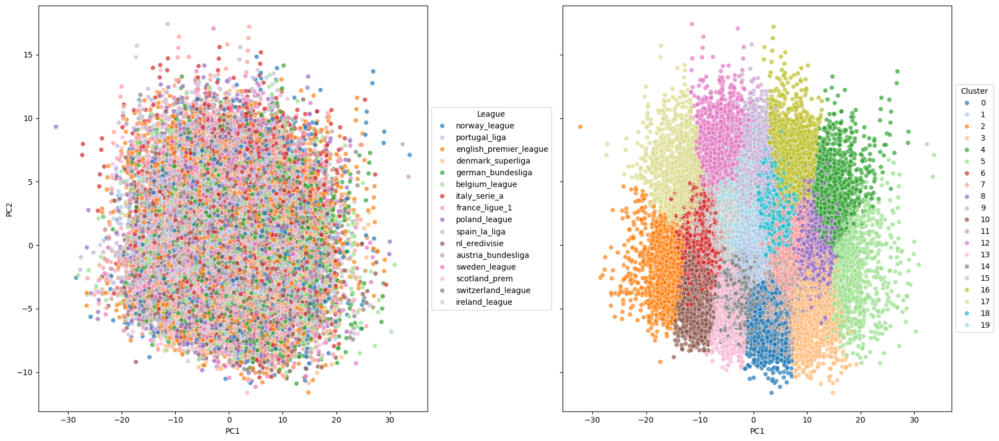

Purity Score: 0.115


In [ ]:
# BEST K (ARI) -- TRAIN
best_k = max(results, key=lambda x: x[2])[0]
kmeans_best = KMeans(n_clusters=best_k, random_state=22, n_init='auto')
labels_best = kmeans_best.fit_predict(X_train)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train)

# Dataframe for comparison -- ChatGPT
df_vis = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'KMeans_Label': labels_best,
    'League': y_train.values
})

# True League vs KMeans Clusters
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('PCA Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='KMeans_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f'PCA Projection Colored by K-Means Clusters (k={best_k})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/KMeans(k={best_k})+PCA True v. Clusters TRAIN.png")
plt.show()
plt.close()

purity = purity_score(y_train, labels_best)
print(f"Purity Score: {purity:.3f}")

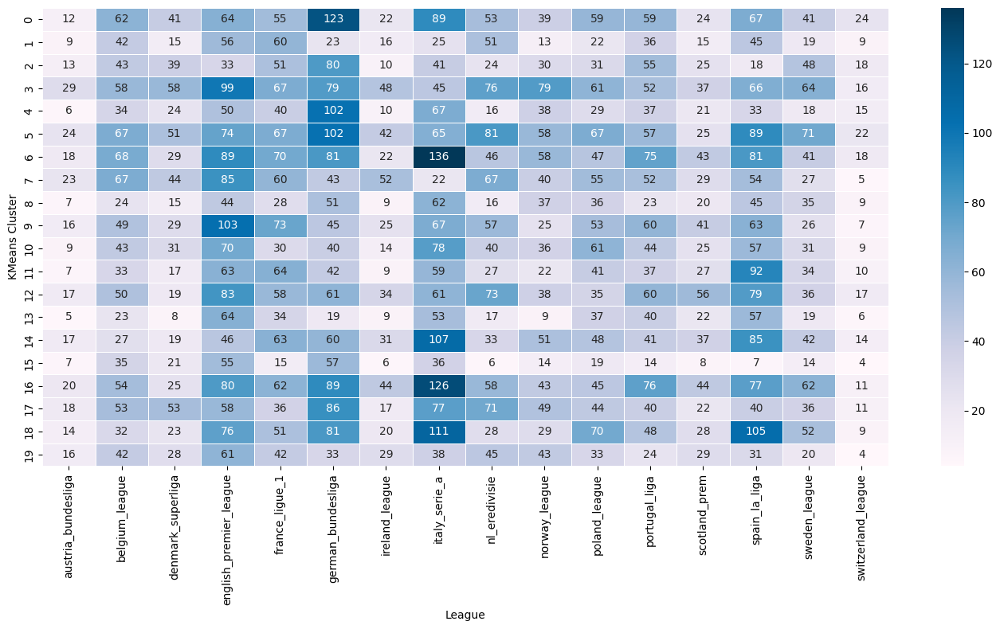

In [ ]:
# HEATMAP BEST K -- TRAIN
crosstab = pd.crosstab(df_vis['KMeans_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'KMeans Clusters vs Leagues (k={best_k})')
plt.xlabel('League')
plt.ylabel('KMeans Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP KMeans(k={best_k}) TRAIN.png")
plt.show()
plt.close()


K = 20 | Silhouette = 0.1539357673769316 | ARI = 0.003943304538042706


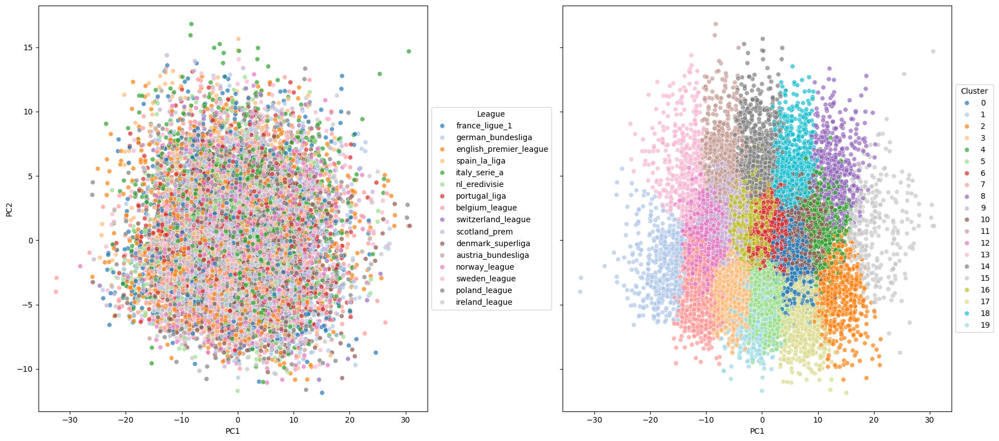

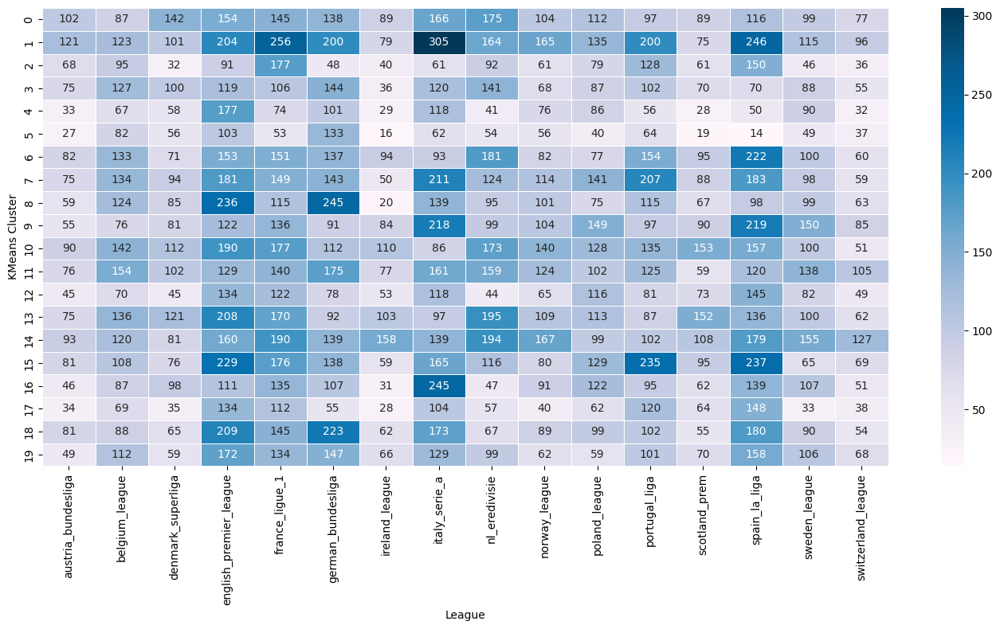

Purity Score: 0.135


In [ ]:
# BEST K -- VAL
kmeans = KMeans(n_clusters=best_k, random_state=22, n_init='auto')
labels = kmeans.fit_predict(X_val)
sil = silhouette_score(X_val, labels)
ari = adjusted_rand_score(y_val, labels)

# Display metrics
print(f"K = {best_k} | Silhouette = {sil} | ARI = {ari}")


kmeans_val = KMeans(n_clusters=best_k, random_state=22, n_init='auto')
labels_val = kmeans_val.fit_predict(X_val)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_val)

df_vis = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'KMeans_Label': labels_val,
    'League': y_val.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('PCA Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='KMeans_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f'PCA Projection Colored by K-Means Clusters (k={best_k})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/KMeans(k={best_k})+PCA True v. Clusters VAL.png")
plt.show()
plt.close()

# HEATMAP
plt.figure(figsize=(14, 8))
sns.heatmap(crosstab, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'KMeans Clusters vs Leagues (k={best_k})')
plt.xlabel('League')
plt.ylabel('KMeans Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP KMeans(k={best_k}) VAL.png")
plt.show()
plt.close()

purity = purity_score(y_val, labels_val)
print(f"Purity Score: {purity:.3f}")

K = 20 | Silhouette = 0.15076763209871893 | ARI = 0.004641210645355253


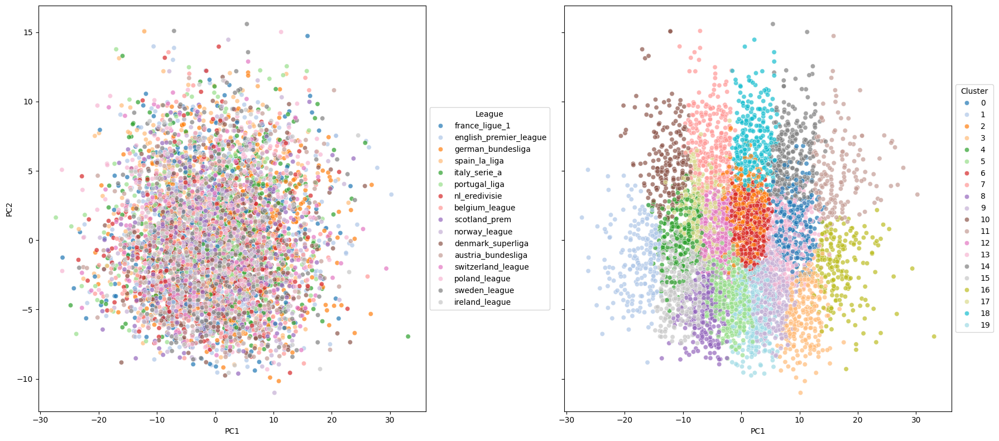

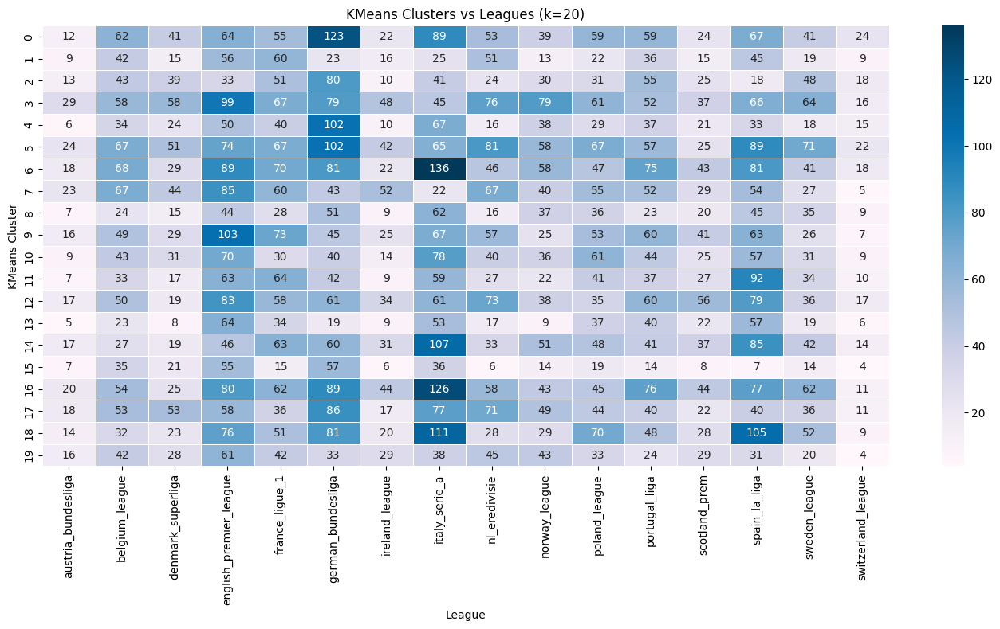

Purity Score: 0.122


In [ ]:
# BEST K -- TEST
kmeans = KMeans(n_clusters=best_k, random_state=22, n_init='auto')
labels = kmeans.fit_predict(X_test)
sil = silhouette_score(X_test, labels)
ari = adjusted_rand_score(y_test, labels)

# Display metrics
print(f"K = {best_k} | Silhouette = {sil} | ARI = {ari}")


kmeans_test = KMeans(n_clusters=best_k, random_state=22, n_init='auto')
labels_test = kmeans_test.fit_predict(X_test)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_test)

df_vis = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'KMeans_Label': labels_test,
    'League': y_test.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('PCA Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='KMeans_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f'PCA Projection Colored by K-Means Clusters (k={best_k})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/KMeans(k={best_k})+PCA True v. Clusters TEST.png")
plt.show()
plt.close()


# HEATMAP
plt.figure(figsize=(14, 8))
sns.heatmap(crosstab, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
plt.title(f'KMeans Clusters vs Leagues (k={best_k})')
plt.xlabel('League')
plt.ylabel('KMeans Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP KMeans(k={best_k}) TEST.png")
plt.show()
plt.close()


purity = purity_score(y_test, labels_test)
print(f"Purity Score: {purity:.3f}")

##**2. GMM ANALYSIS - ALL LEAGUES**

n     Silhouette  ARI       
5     -0.051      0.002     
6     -0.090      -0.000    
8     -0.088      0.006     
12    -0.126      0.006     
16    -0.142      0.008     
20    -0.144      0.009     
26    -0.192      0.010     


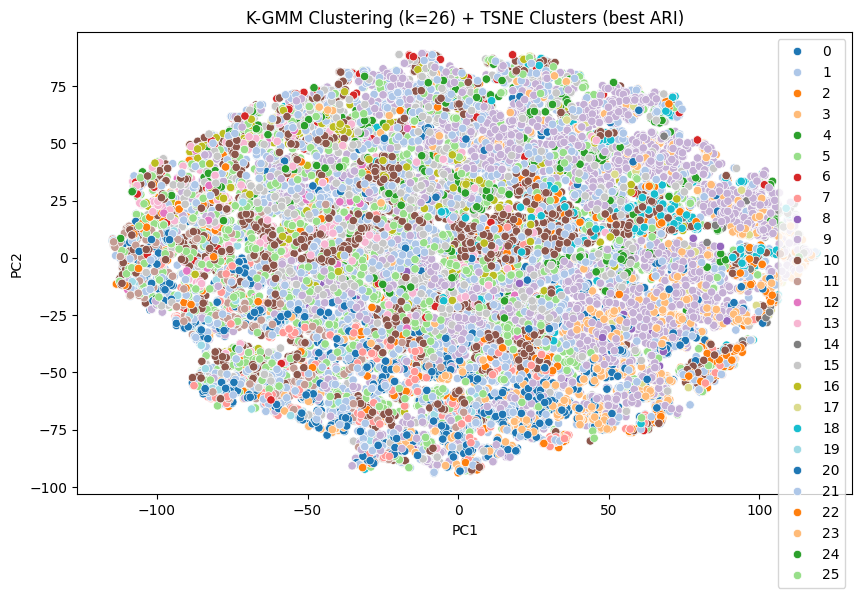

Text(0, 0.5, 'PC2')

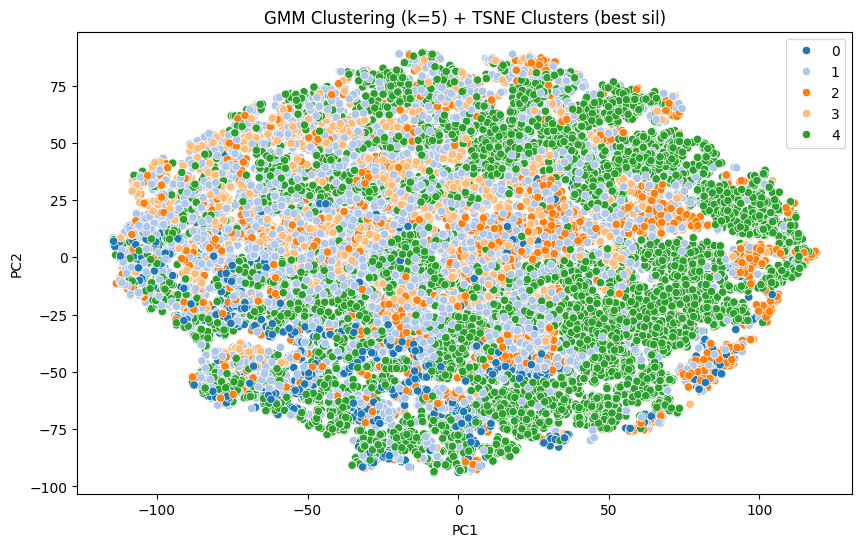

In [ ]:
n_components_list = [5, 6, 8, 12, 16, 20, 26] #GMM optimal-k
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_train)

    sil = silhouette_score(X_train, gmm_labels)
    ari = adjusted_rand_score(y_train, gmm_labels)
    results_gmm.append((n, sil, ari))

# Table with metrics ARI & SIL
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")

#BEST K - ARI
best_n_ari = max(results_gmm, key=lambda x: x[2])[0]
gmm_best_ari = GaussianMixture(n_components=best_n_ari, random_state=22)
gmm_labels_best_ari = gmm_best_ari.fit_predict(X_train)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_train)

# Plot ARI best
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=gmm_labels_best_ari, palette='tab20', legend='full')
plt.title(f'K-GMM Clustering (k={best_n_ari}) + TSNE Clusters (best ARI)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.show()

#BEST K - SIL
best_n_sil = max(results_gmm, key=lambda x: x[1])[0]
gmm_best_sil = GaussianMixture(n_components=best_n_sil, random_state=22)
gmm_labels_best_sil = gmm_best_sil.fit_predict(X_train)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_train)

# Plot Silhouette best
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=gmm_labels_best_sil, palette='tab20', legend='full')
plt.title(f'GMM Clustering (k={best_n_sil}) + TSNE Clusters (best sil)')
plt.xlabel('PC1')
plt.ylabel('PC2')

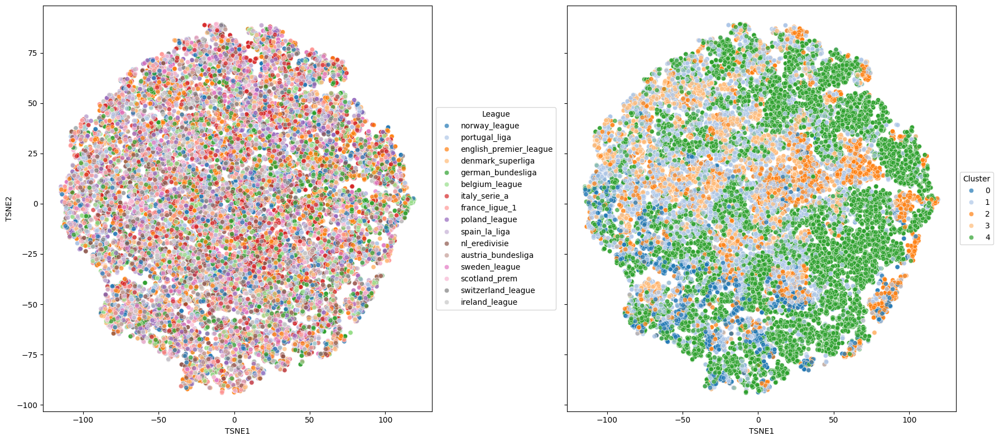

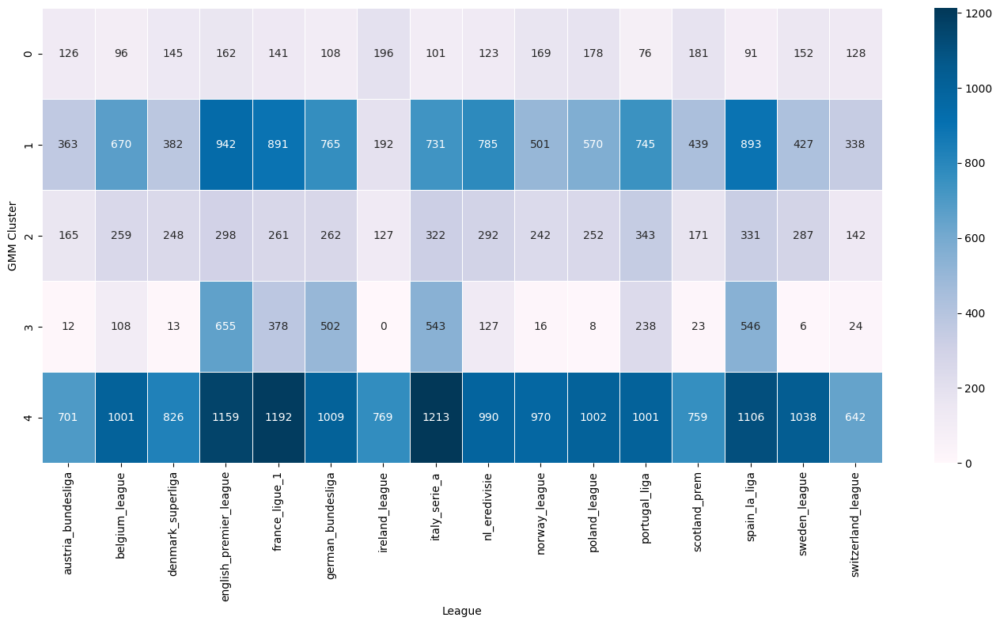

Purity Score: 0.097


In [ ]:
# BEST N (SIL) -- TRAIN
best_n = max(results_gmm, key=lambda x: x[1])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_train)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_train)

# Dataframe for comparison -- ChatGPT
df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_train.values
})

# True League vs KMeans Clusters
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/GMM(k={best_n})+TSNE True v. Clusters TRAIN.png")
plt.show()
plt.close()

# HEATMAP BEST N -- TRAIN
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP GMM(k={best_n}) TRAIN.png")
plt.show()
plt.close()

purity = purity_score(y_train, gmm_labels_best)
print(f"Purity Score: {purity:.3f}")

K = 5 | Silhouette = -0.03261467498482504 | ARI = 0.001981928903573486


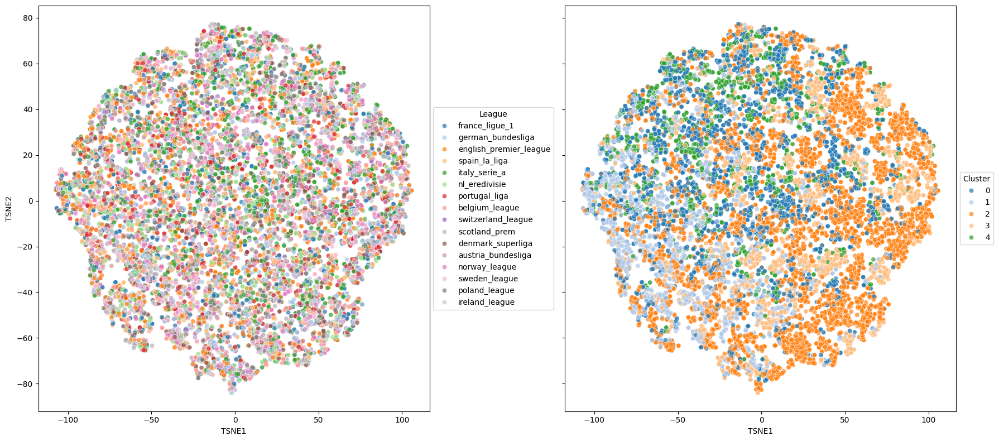

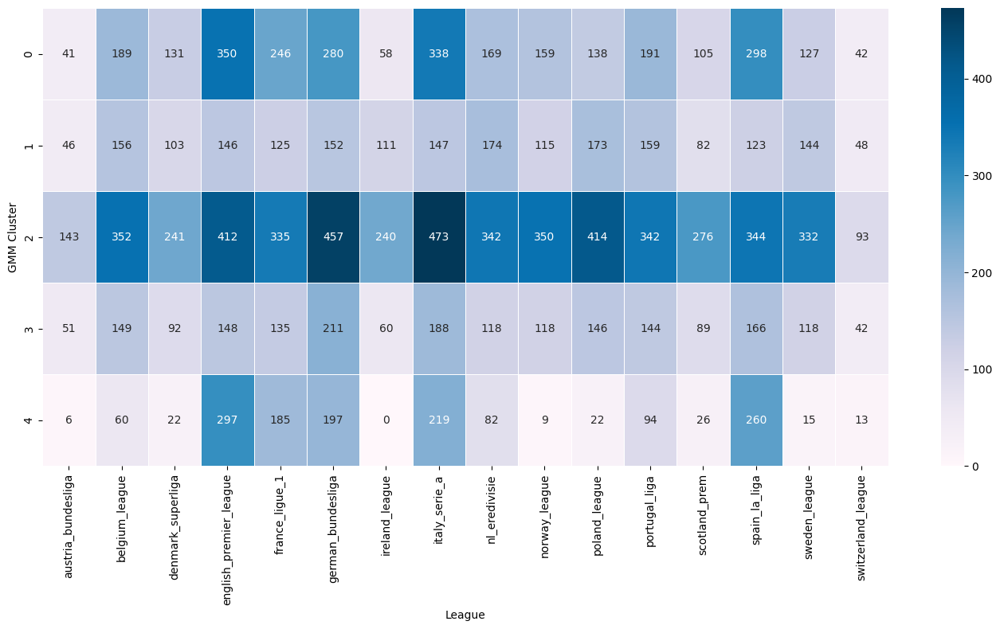


Purity Score (GMM): 0.112


In [ ]:
# BEST N -- VAL
gmm = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels = gmm.fit_predict(X_val)
sil = silhouette_score(X_val, gmm_labels)
ari = adjusted_rand_score(y_val, gmm_labels)

# Display metrics
print(f"K = {best_n} | Silhouette = {sil} | ARI = {ari}")


gmm_val = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_val = gmm_val.fit_predict(X_val)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_val)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_val,
    'League': y_val.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

# Plot 2: GMM cluster assignments
sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/GMM(k={best_n})+TSNE True v. Clusters VAL.png")
plt.show()
plt.close()


# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP GMM(k={best_n}) VAL.png")
plt.show()
plt.close()



purity = purity_score(y_val, gmm_labels_val)
print(f"\nPurity Score (GMM): {purity:.3f}")

K = 5 | Silhouette = -0.027131102819128457 | ARI = 0.005710711095441535


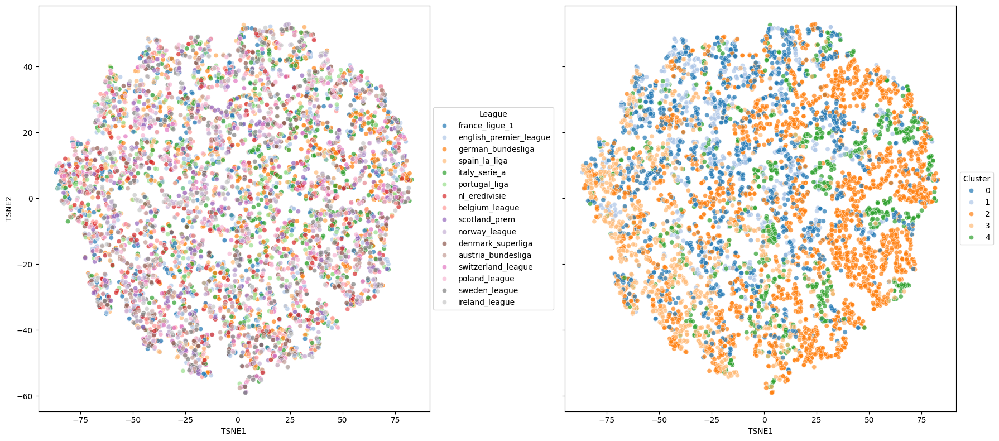

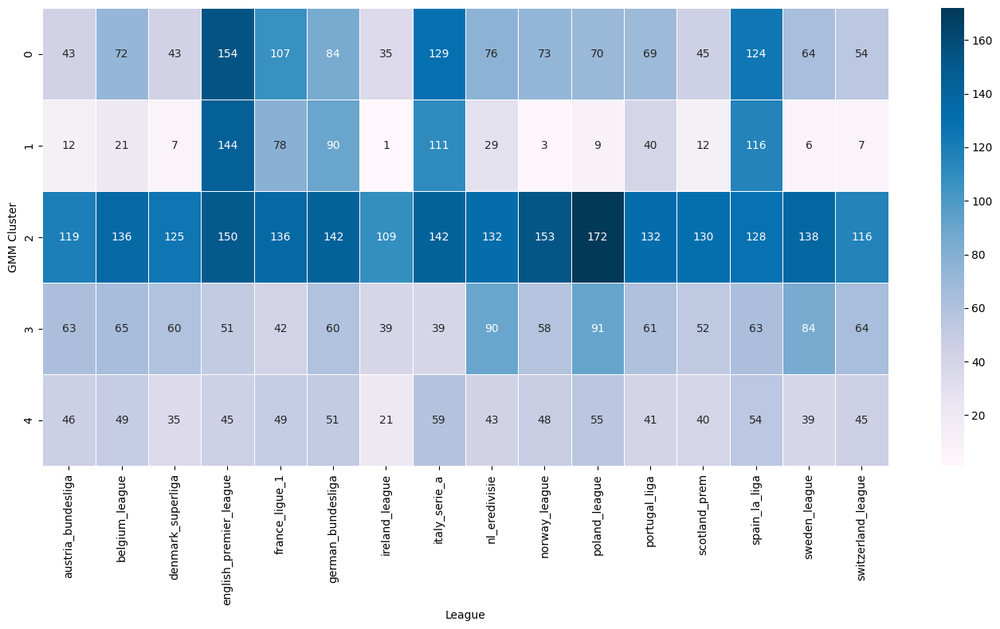


Purity Score (GMM): 0.107


In [ ]:
# BEST N -- TEST
gmm = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels = gmm.fit_predict(X_test)
sil = silhouette_score(X_test, gmm_labels)
ari = adjusted_rand_score(y_test, gmm_labels)

# Display metrics
print(f"K = {best_n} | Silhouette = {sil} | ARI = {ari}")


gmm_test = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_test = gmm_test.fit_predict(X_test)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_test)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_test,
    'League': y_test.values
})

#  Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

# Plot 2: GMM cluster assignments
sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/GMM(n={best_n})+TSNE True v. Clusters TEST.png")
plt.show()
plt.close()


# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP GMM(n={best_n}) TEST.png")
plt.show()
plt.close()


purity = purity_score(y_test, gmm_labels_test)
print(f"\nPurity Score (GMM): {purity:.3f}")

##**3.REDUCED LABELS PERFORMANCE**

In [ ]:
#LABEL REDUCTION
leagues = [
    'english_premier_league', 'spain_la_liga', 'italy_serie_a',
    'france_ligue_1', 'german_bundesliga', 'nl_eredivisie',
    'portugal_liga', 'scotland_prem'
]

# MASK
mask_train = y_train.isin(leagues)
mask_val = y_val.isin(leagues)
mask_test = y_test.isin(leagues)

# FILTER
X_train_top_leagues = X_train[mask_train].reset_index(drop=True)
y_train_top_leagues = y_train[mask_train].reset_index(drop=True)

X_val_top_leagues = X_val[mask_val].reset_index(drop=True)
y_val_top_leagues = y_val[mask_val].reset_index(drop=True)

X_test_top_leagues = X_test[mask_test].reset_index(drop=True)
y_test_top_leagues = y_test[mask_test].reset_index(drop=True)

###*KMeans*

K = 20 | Silhouette = 0.14981830768677723 | ARI = 0.005093198402576199


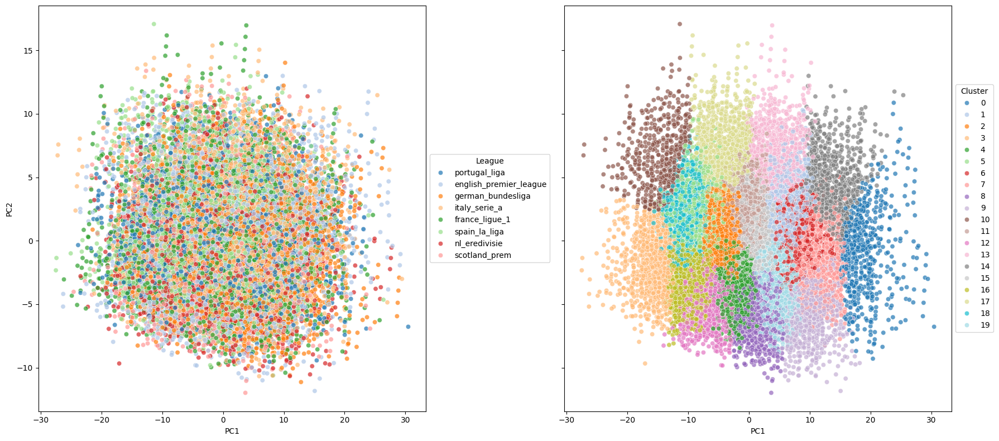

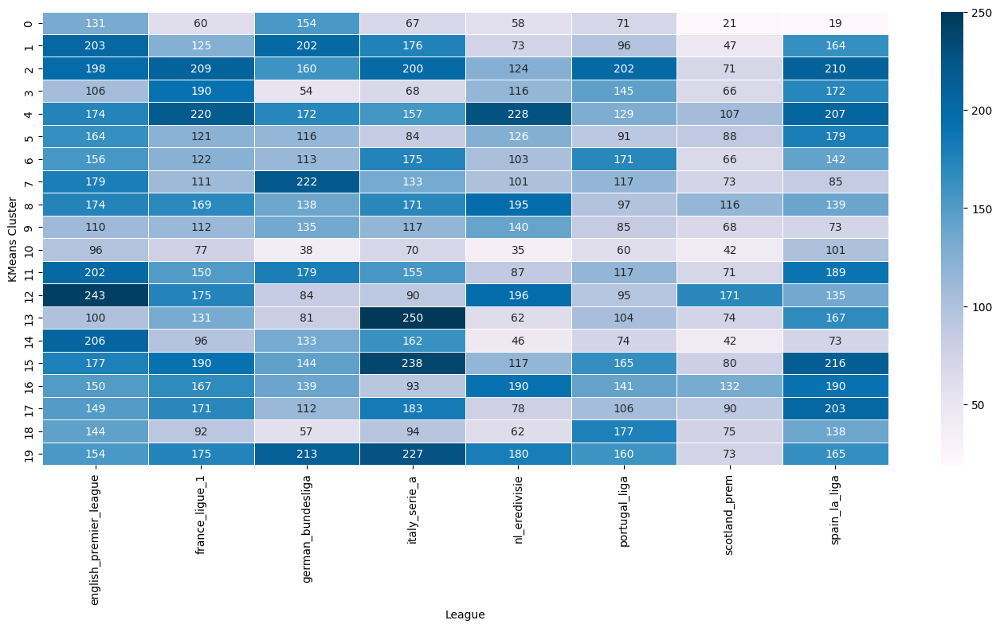


Purity Score (KMeans): 0.188


In [ ]:
k = best_k
kmeans_top = KMeans(n_clusters=k, random_state=22, n_init='auto')
kmeans_labels_top = kmeans_top.fit_predict(X_train_top_leagues)
sil = silhouette_score(X_train_top_leagues, kmeans_labels_top)
ari = adjusted_rand_score(y_train_top_leagues, kmeans_labels_top)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train_top_leagues)

# Display metrics
print(f"K = {k} | Silhouette = {sil} | ARI = {ari}")

df_vis = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'KMeans_Label': kmeans_labels_top,
    'League': y_train_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('PCA Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='PC1', y='PC2', hue='KMeans_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f'PCA Projection Colored by KMeans Clusters (k={k})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/REDUCED KMeans(k={k})+PCA TRAIN.png")
plt.show()
plt.close()


# HEATMAP
crosstab_kmeans = pd.crosstab(df_vis['KMeans_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_kmeans, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'KMeans Clusters vs Leagues (n_components={k})')
plt.xlabel('League')
plt.ylabel('KMeans Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP REDUCED KMeans(k={k}) TRAIN.png")
plt.show()
plt.close()



purity = purity_score(y_train_top_leagues, kmeans_labels_top)
print(f"\nPurity Score (KMeans): {purity:.3f}")

###*GMM - BEST N*

K = 5 | Silhouette = -0.029102945126107324 | ARI = 0.004722622856282095


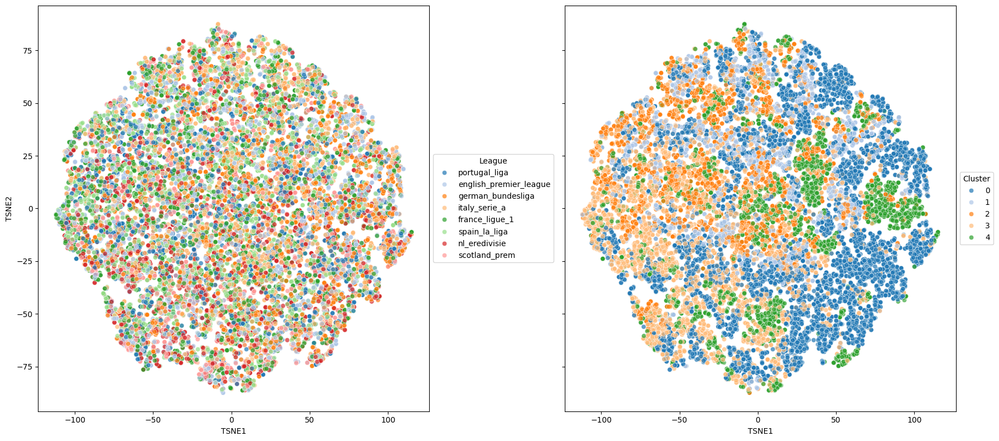

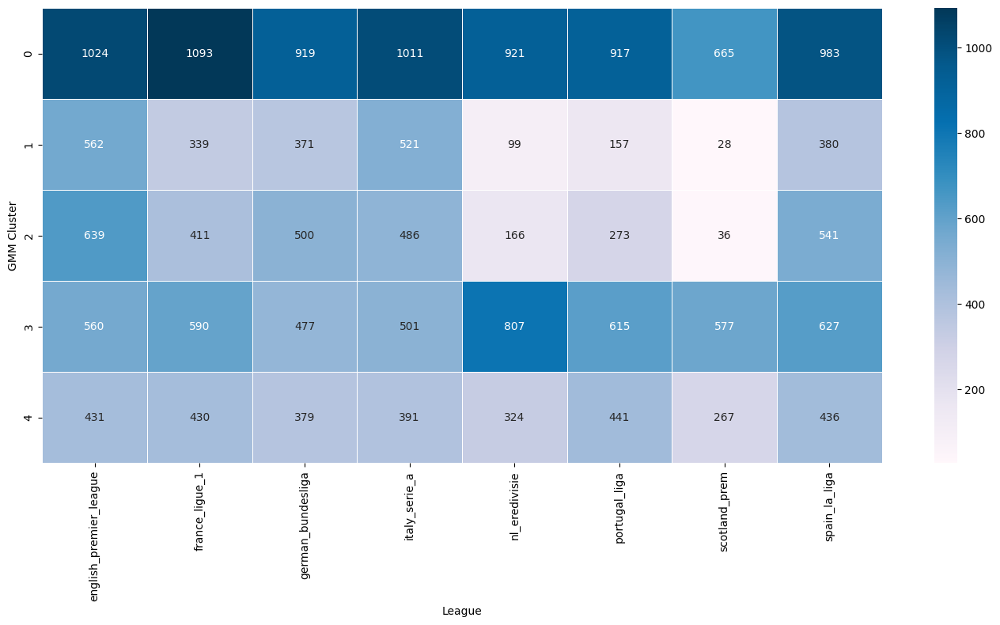


Purity Score (GMM): 0.170


In [ ]:
n = best_n
gmm_top_train = GaussianMixture(n_components=n, random_state=22)
gmm_labels_top_train = gmm_top_train.fit_predict(X_train_top_leagues)
sil = silhouette_score(X_train_top_leagues, gmm_labels_top_train)
ari = adjusted_rand_score(y_train_top_leagues, gmm_labels_top_train)

# Display metrics
print(f"K = {n} | Silhouette = {sil} | ARI = {ari}")

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_train_top_leagues)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_top_train,
    'League': y_train_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/REDUCED GMM(n={n}) TRAIN.png")
plt.show()
plt.close()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP REDUCED GMM(n={n}) TRAIN.png")
plt.show()
plt.close()



purity = purity_score(y_train_top_leagues, gmm_labels_top_train)
print(f"\nPurity Score (GMM): {purity:.3f}")

K = 5 | Silhouette = -0.013618566076945235 | ARI = 0.008262525084165258


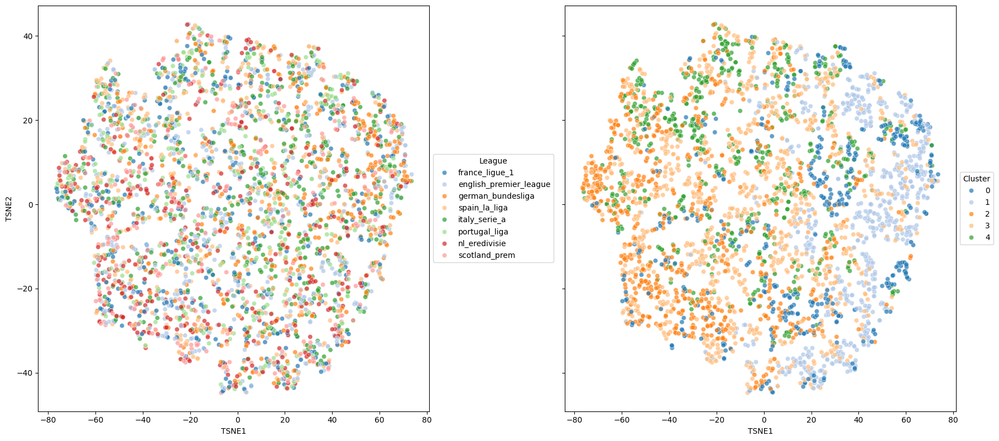

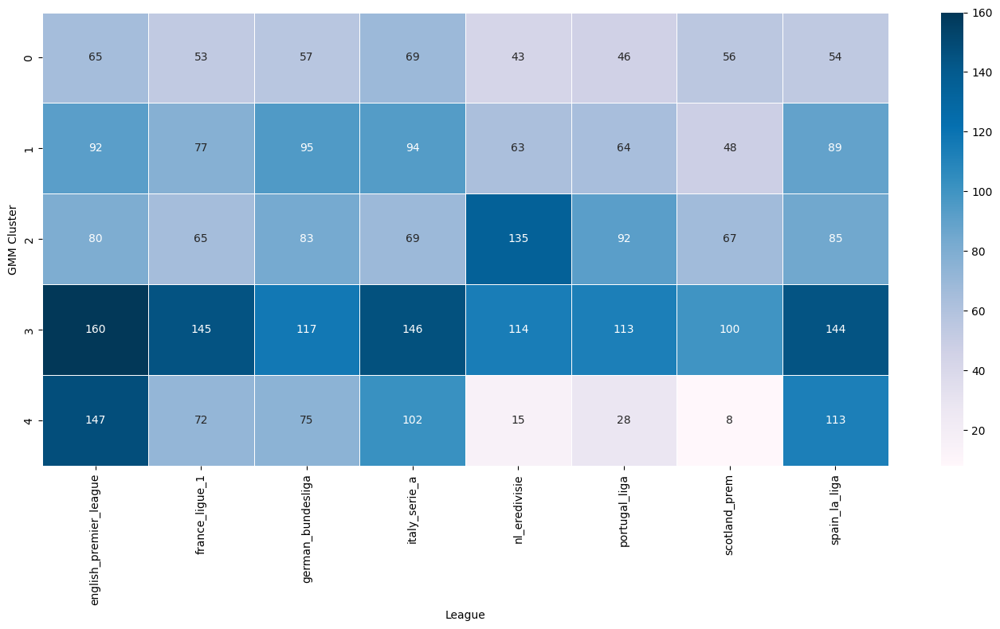


Purity Score (GMM): 0.181


In [ ]:
n = best_n
gmm_top = GaussianMixture(n_components=n, random_state=22)
gmm_labels_top = gmm_top.fit_predict(X_test_top_leagues)
sil = silhouette_score(X_test_top_leagues, gmm_labels_top)
ari = adjusted_rand_score(y_test_top_leagues, gmm_labels_top)

# Display metrics
print(f"K = {n} | Silhouette = {sil} | ARI = {ari}")

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_test_top_leagues)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_top,
    'League': y_test_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/REDUCED GMM(n={n}) TEST.png")
plt.show()
plt.close()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP REDUCED GMM(n={n}) TEST.png")
plt.show()
plt.close()



purity = purity_score(y_test_top_leagues, gmm_labels_top)
print(f"\nPurity Score (GMM): {purity:.3f}")

###*GMM - Lower N*

In [ ]:
n_components_list = [2, 3, 4, 5, 6, 8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_train_top_leagues)

    sil = silhouette_score(X_train_top_leagues, gmm_labels)
    ari = adjusted_rand_score(y_train_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")

n     Silhouette  ARI       
2     0.047       0.000     
3     0.036       0.002     
4     -0.021      0.002     
5     -0.029      0.005     
6     -0.076      0.000     
8     -0.082      0.006     


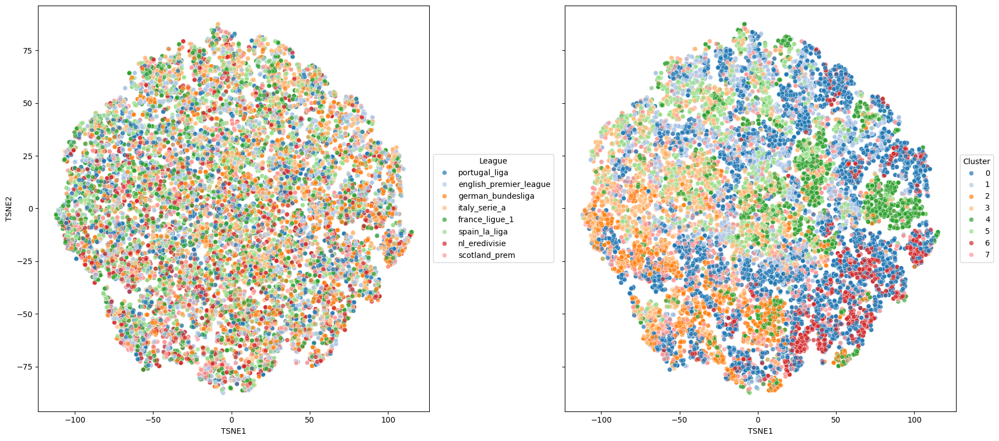

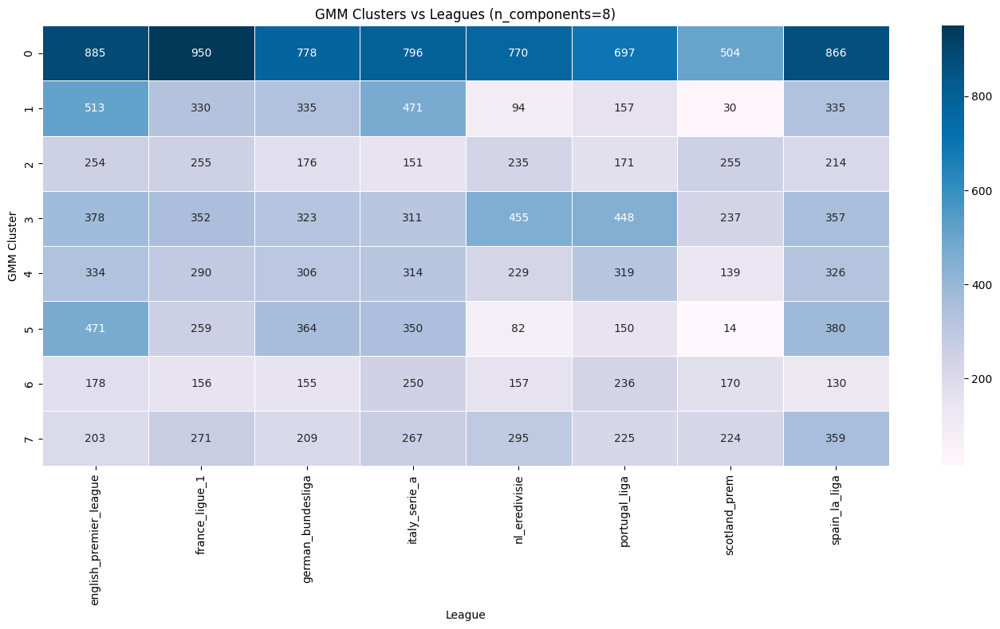


Purity Score (GMM): 0.172


In [ ]:
best_n = 8
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_train_top_leagues)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_train_top_leagues)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_train_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
#plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/REDUCED GMM(n={best_n}) TRAIN.png")
plt.show()
plt.close()

# Step 6: Cluster-League Crosstab and Heatmap
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
#plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP REDUCED GMM(n={best_n}) TRAIN.png")
plt.show()
plt.close()


purity = purity_score(y_train_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

n     Silhouette  ARI       
2     0.055       0.000     
3     0.013       0.002     
4     -0.007      0.001     
5     -0.027      0.002     
6     -0.053      0.002     
8     -0.078      0.001     


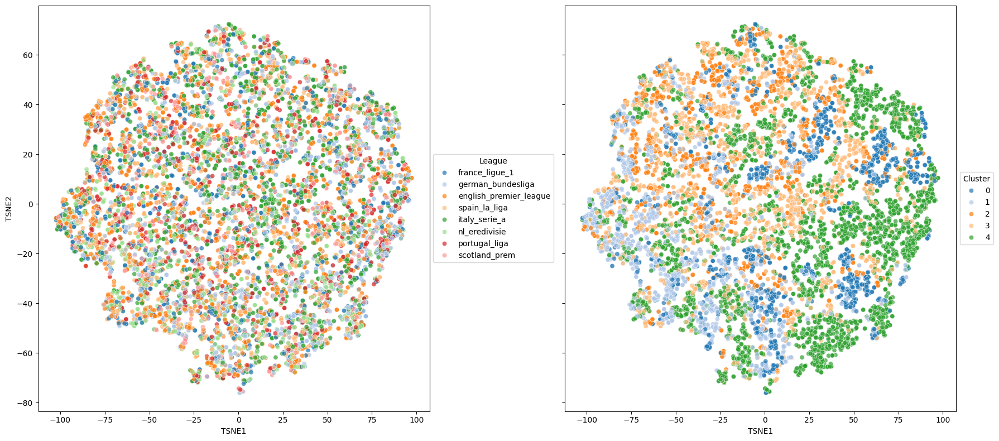

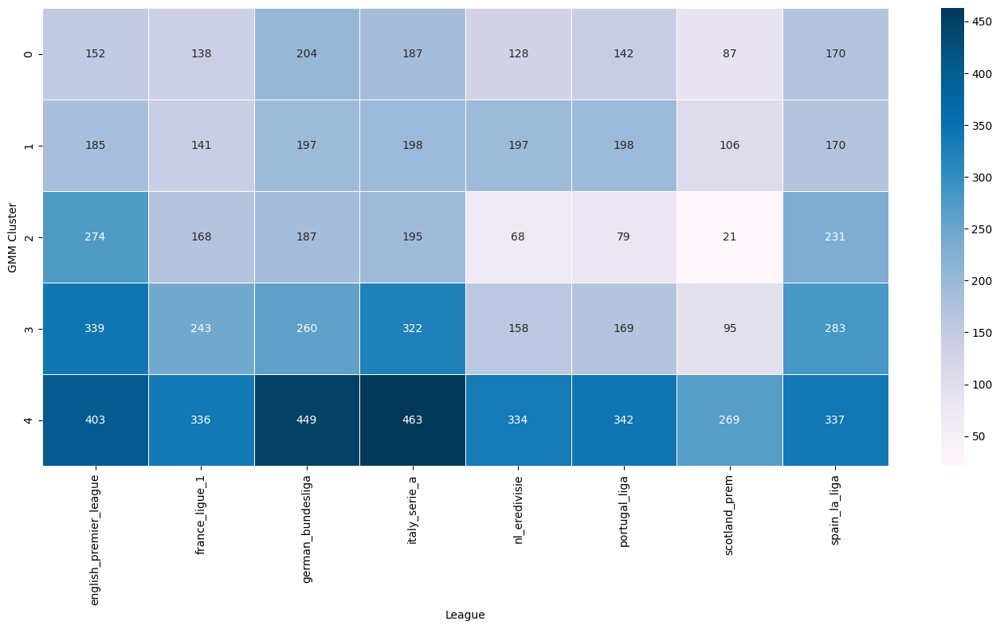


Purity Score (GMM): 0.171


In [ ]:
n_components_list = [2, 3, 4, 5, 6, 8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_val_top_leagues)

    sil = silhouette_score(X_val_top_leagues, gmm_labels)
    ari = adjusted_rand_score(y_val_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_val_top_leagues)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_val_top_leagues)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_val_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/REDUCED GMM(n={best_n}) VAL.png")
plt.show()
plt.close()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP REDUCED GMM(n={best_n}) VAL.png")
plt.show()
plt.close()

purity = purity_score(y_val_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

n     Silhouette  ARI       
2     0.076       0.004     
3     0.025       0.007     
4     -0.008      0.008     
5     -0.014      0.008     
6     -0.038      0.018     
8     -0.089      0.008     


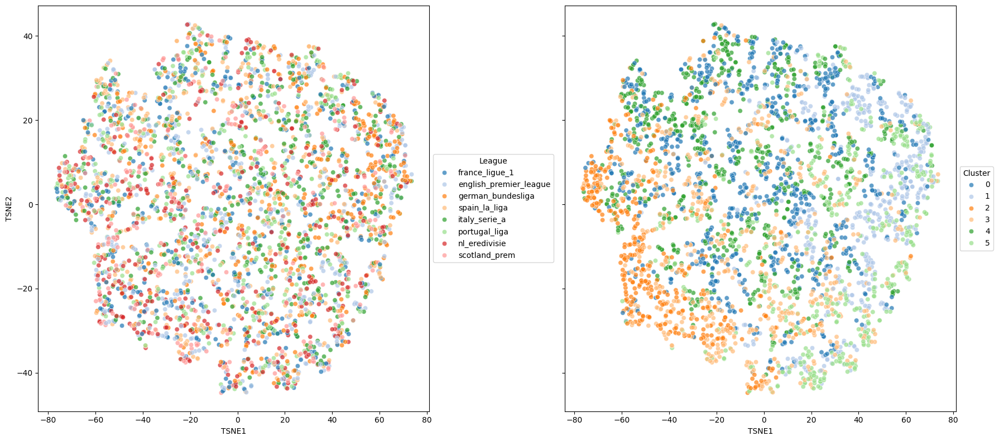

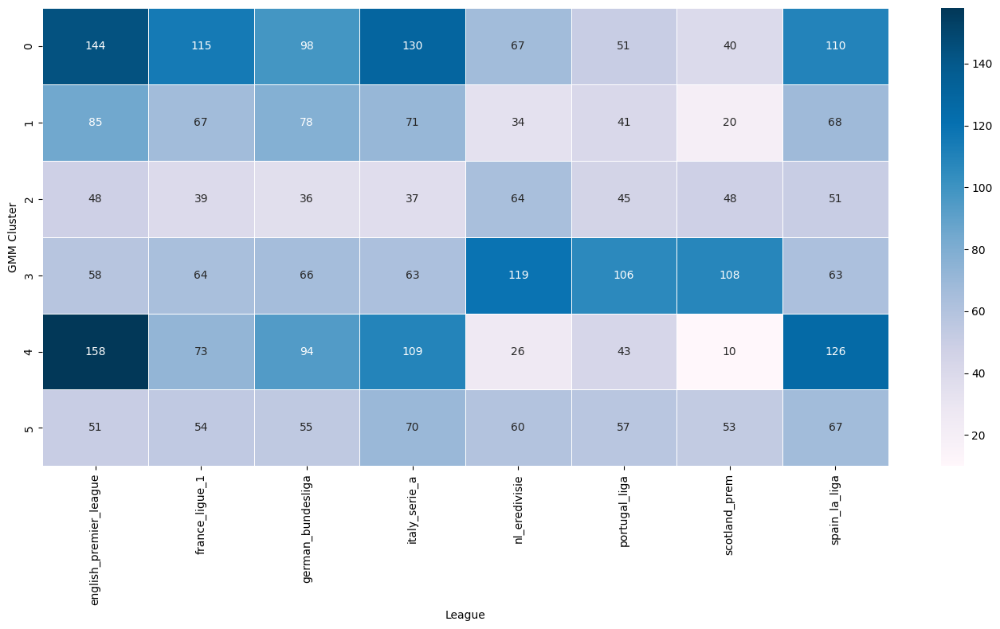


Purity Score (GMM): 0.192


In [ ]:
n_components_list = [2, 3, 4, 5, 6, 8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_test_top_leagues)

    sil = silhouette_score(X_test_top_leagues, gmm_labels)
    ari = adjusted_rand_score(y_test_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_test_top_leagues)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_test_top_leagues)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_test_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/REDUCED GMM(n={best_n}) TEST.png")
plt.show()
plt.close()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP REDUCED GMM(n={best_n}) TEST.png")
plt.show()
plt.close()



purity = purity_score(y_test_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

##**OTHER ANANLYSIS**
###*DBSCAN*

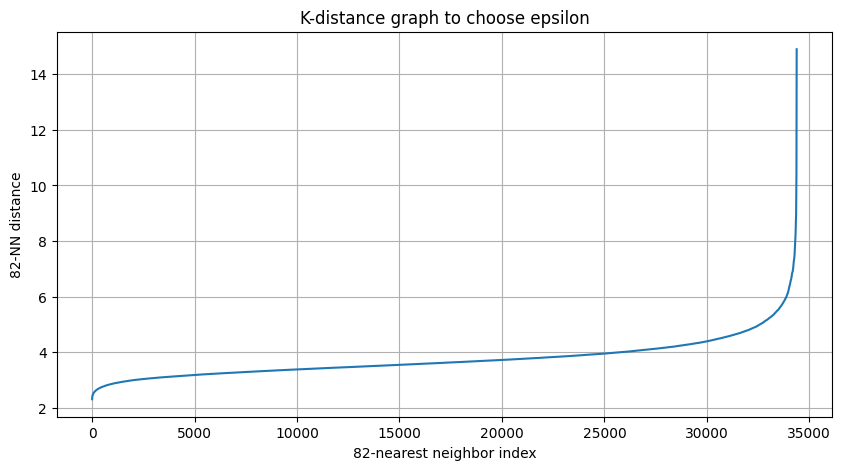

In [ ]:
#K-DISTANCE PLOT
min_pts = 82  # 2 * 41 features

neighbors = NearestNeighbors(n_neighbors=min_pts)
neighbors_fit = neighbors.fit(X_train)
distances, indices = neighbors_fit.kneighbors(X_train)

# ChatGPT: Sort distances
k_distances = np.sort(distances[:, -1])

#PLOT
plt.figure(figsize=(10, 5))
plt.plot(k_distances)
plt.xlabel(f"{min_pts}-nearest neighbor index")
plt.ylabel(f"{min_pts}-NN distance")
plt.title("K-distance graph to choose epsilon")
plt.grid(True)
plt.show()


Eps   Clusters  Silhouette  ARI       
3.0   2         -0.172      0.002     
4.0   1         0.325       -0.000    
4.5   1         0.387       -0.000    
5.0   1         0.439       -0.000    
5.5   1         0.480       -0.000    
6.0   1         0.498       -0.000    


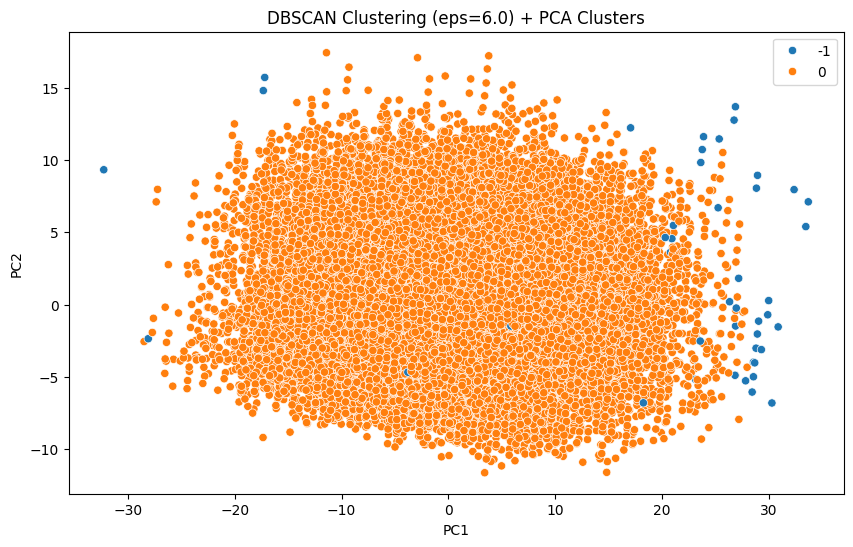

In [ ]:
#DBSCAN

eps_values = [3.0, 4.0, 4.5, 5.0, 5.5, 6.0]  #from the plot
results = []

for eps in eps_values:
    db = DBSCAN(eps=eps, min_samples=min_pts)
    labels = db.fit_predict(X_train)

    # Skip if all points are noise
    if len(set(labels)) <= 1:
        continue

    sil = silhouette_score(X_train, labels)
    ari = adjusted_rand_score(y_train, labels)
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

    results.append((eps, n_clusters, sil, ari))

#Table with loop results
print(f"{'Eps':<6}{'Clusters':<10}{'Silhouette':<12}{'ARI':<10}")
for eps, n_clusters, sil, ari in results:
    print(f"{eps:<6}{n_clusters:<10}{sil:<12.3f}{ari:<10.3f}")


best_eps = max(results, key=lambda x: x[2])[0]  # Use highest Silhouette, ARI are all = 0
db_best = DBSCAN(eps=best_eps, min_samples=min_pts)
labels_best = db_best.fit_predict(X_train)

# PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=labels_best, palette='tab10', legend='full')
plt.title(f'DBSCAN Clustering (eps={best_eps}) + PCA Clusters')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.show()

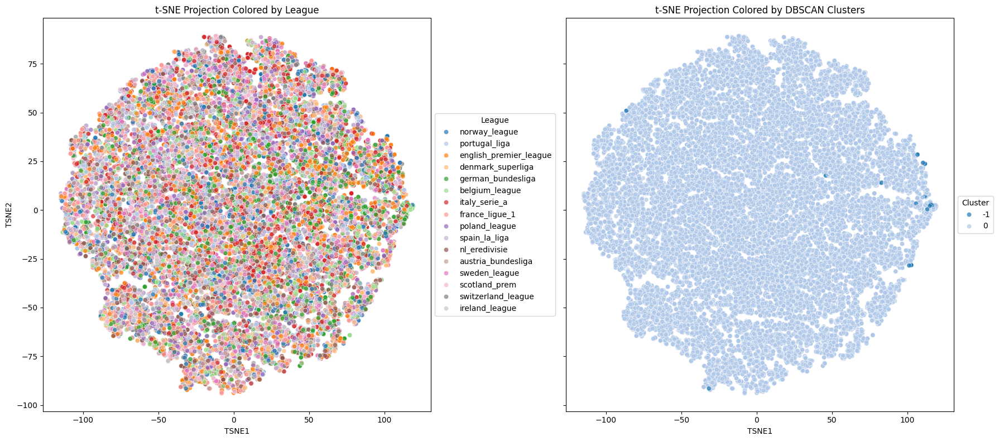

In [ ]:
#TSNE + DBSCAN
tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_train)

min_pts = 82
dbscan = DBSCAN(eps=6.0, min_samples=min_pts)
db_labels = dbscan.fit_predict(X_train)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'League': y_train.values,
    'DBSCAN_Label': db_labels
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0], legend='full')
axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='DBSCAN_Label', palette='tab20', alpha=0.7, ax=axes[1], legend='full')
axes[1].set_title('t-SNE Projection Colored by DBSCAN Clusters')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.show()

###*Reduction dimensionality*

n     Silhouette  ARI       
2     0.192       -0.000    
3     0.003       0.002     
4     -0.037      0.003     
5     -0.029      -0.001    
6     -0.097      0.003     
8     -0.087      0.000     


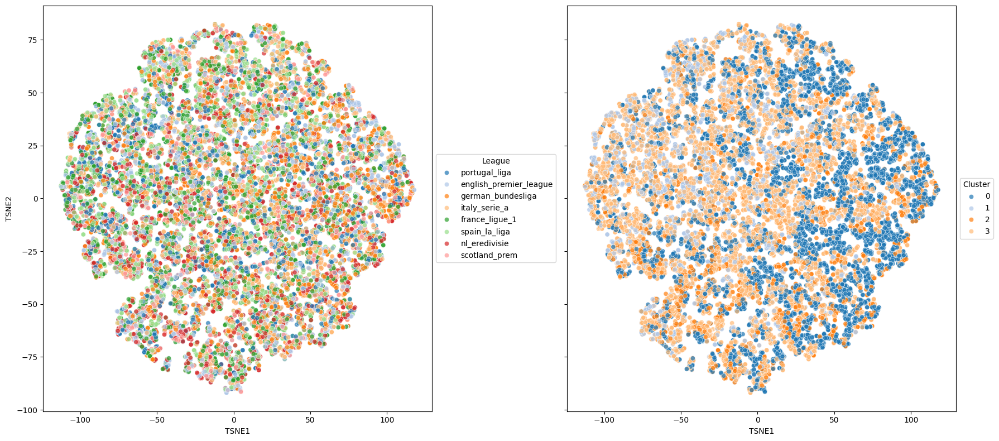

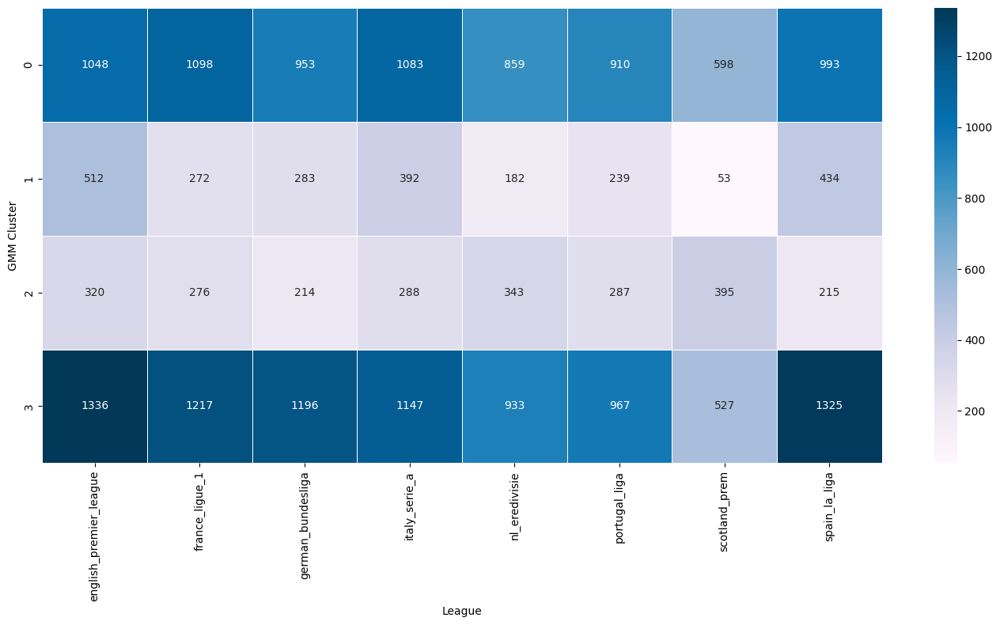


Purity Score (GMM): 0.160


In [ ]:
agglo = FeatureAgglomeration(n_clusters=20)
X_reduced = agglo.fit_transform(X_train_top_leagues)

n_components_list = [2, 3, 4, 5, 6, 8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_reduced)

    sil = silhouette_score(X_reduced, gmm_labels)
    ari = adjusted_rand_score(y_train_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metrics Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")

best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_reduced)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_reduced)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_train_top_leagues.values
})

#Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.show()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.show()




purity = purity_score(y_train_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

In [ ]:
nmi = normalized_mutual_info_score(y_train_top_leagues, gmm_labels_best)
print(f"NMI Score: {nmi:.3f}")

NMI Score: 0.009


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


n     Silhouette  ARI       
2     0.483       0.004     
3     0.388       0.006     
4     0.315       0.005     
5     0.273       0.006     
6     0.276       0.006     
8     0.260       0.006     


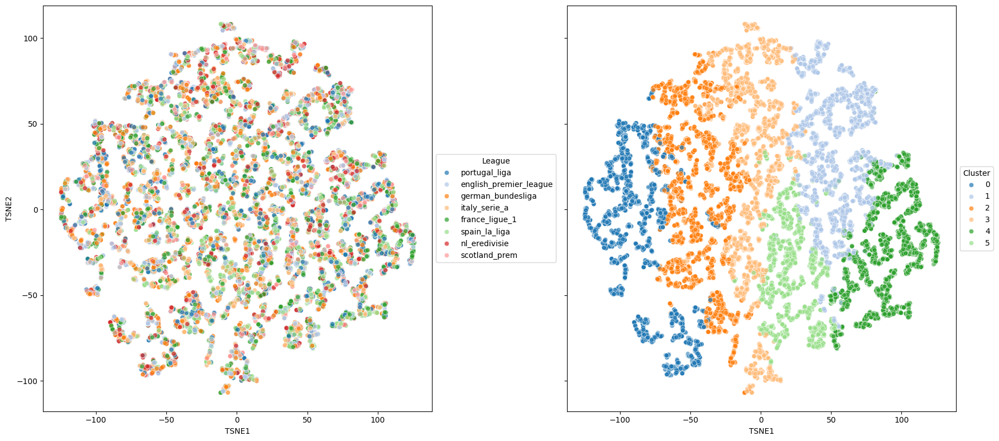

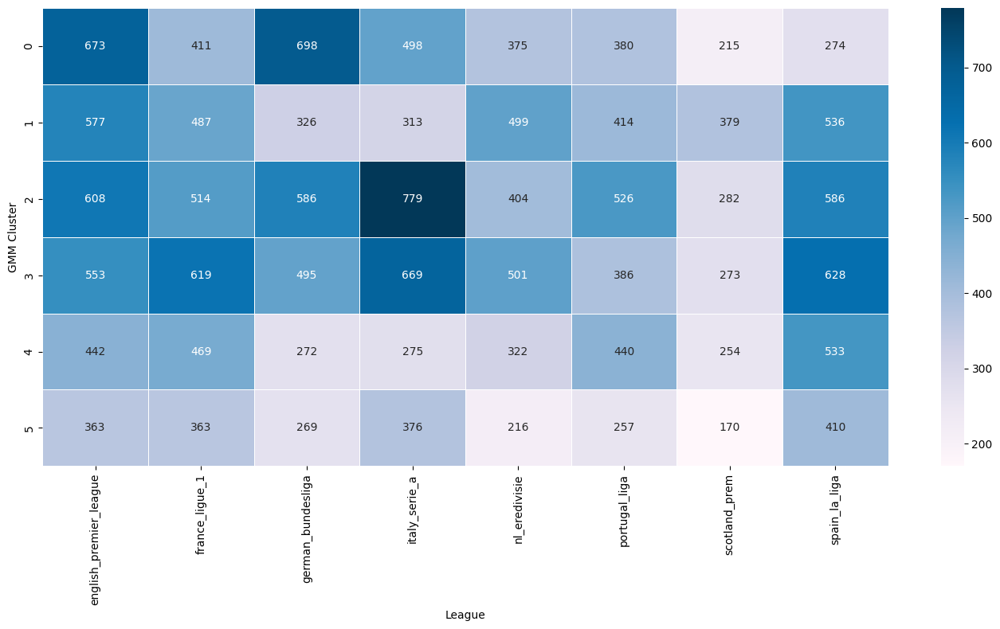


Purity Score (GMM): 0.175


In [ ]:
umap_model = umap.UMAP(n_components=10, random_state=42)
X_umap = umap_model.fit_transform(X_train_top_leagues)

n_components_list = [2, 3, 4, 5, 6, 8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_umap)

    sil = silhouette_score(X_umap, gmm_labels)
    ari = adjusted_rand_score(y_train_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metrics Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_umap)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_umap)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_train_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.show()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.show()



purity = purity_score(y_train_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


n     Silhouette  ARI       
2     0.490       0.007     
3     0.395       0.008     
4     0.321       0.007     
5     0.255       0.005     
6     0.294       0.006     
8     0.298       0.007     


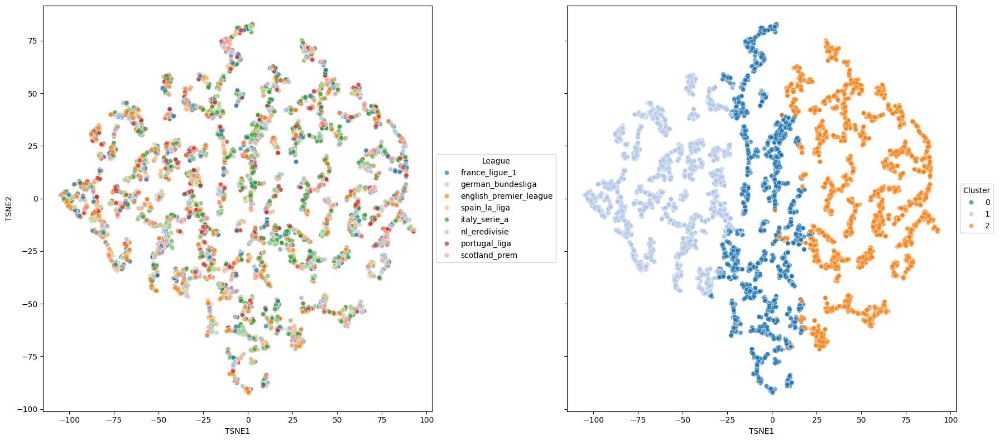

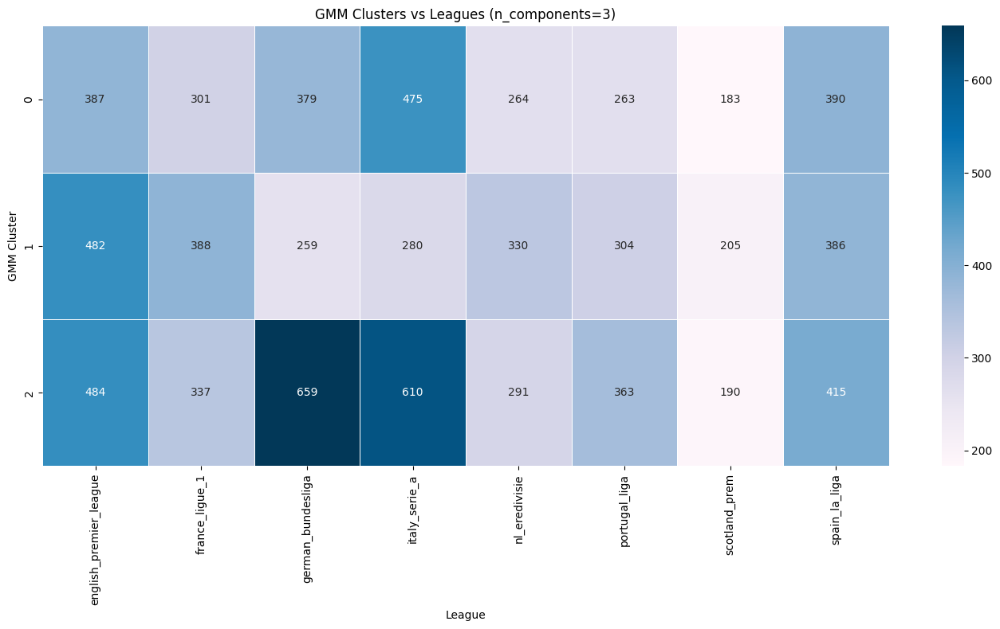


Purity Score (GMM): 0.187


In [ ]:
umap_model = umap.UMAP(n_components=10, random_state=42)
X_umap = umap_model.fit_transform(X_val_top_leagues)


n_components_list = [2, 3, 4, 5, 6, 8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_umap)

    sil = silhouette_score(X_umap, gmm_labels)
    ari = adjusted_rand_score(y_val_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_umap)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_umap)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_val_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.show()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.show()



purity = purity_score(y_val_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


n     Silhouette  ARI       
2     0.477       0.010     
3     0.394       0.007     
4     0.315       0.009     
5     0.331       0.008     
6     0.291       0.008     
8     0.319       0.009     


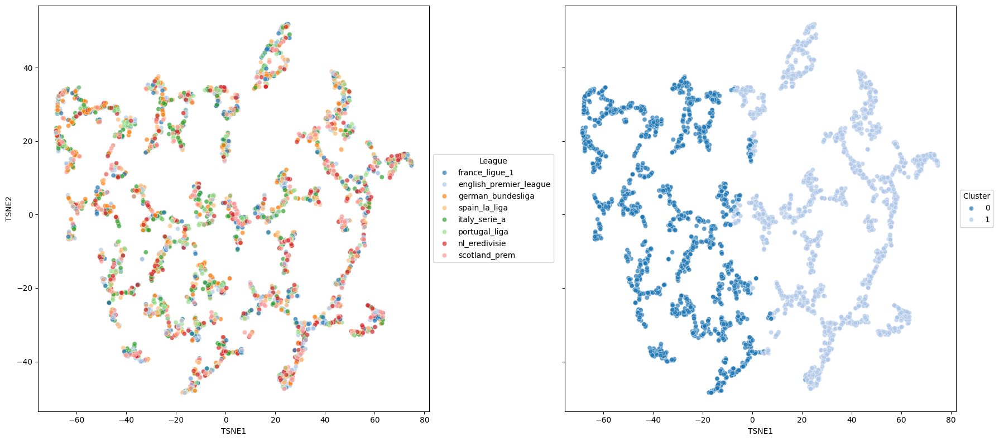

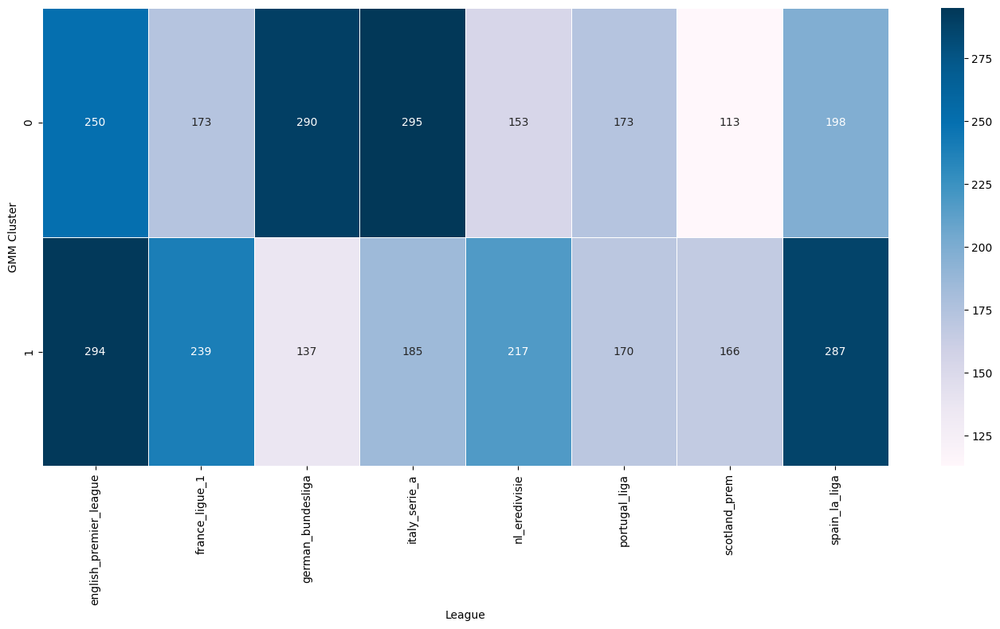


Purity Score (GMM): 0.176


In [ ]:
umap_model = umap.UMAP(n_components=10, random_state=22)
X_umap = umap_model.fit_transform(X_test_top_leagues)


n_components_list = [2, 3, 4, 5, 6, 8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_umap)

    sil = silhouette_score(X_umap, gmm_labels)
    ari = adjusted_rand_score(y_test_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_umap)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_umap)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_test_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.show()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.show()



purity = purity_score(y_test_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


n     Silhouette  ARI       
5     0.331       0.008     


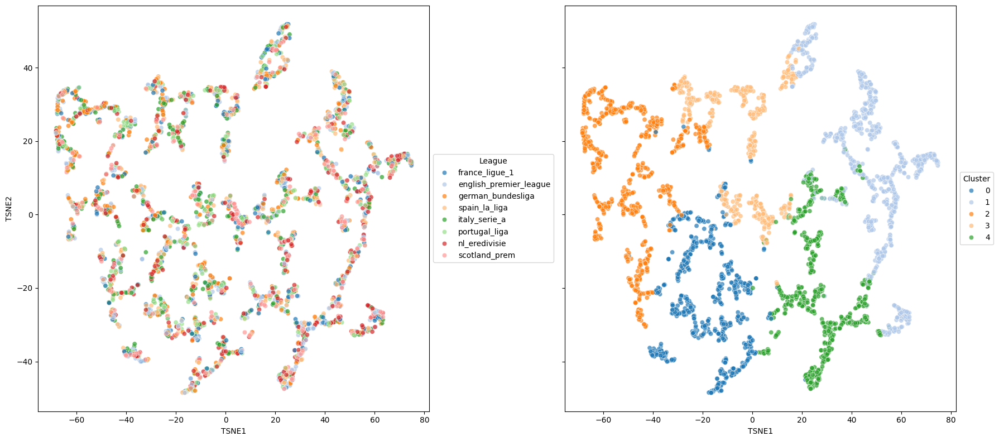

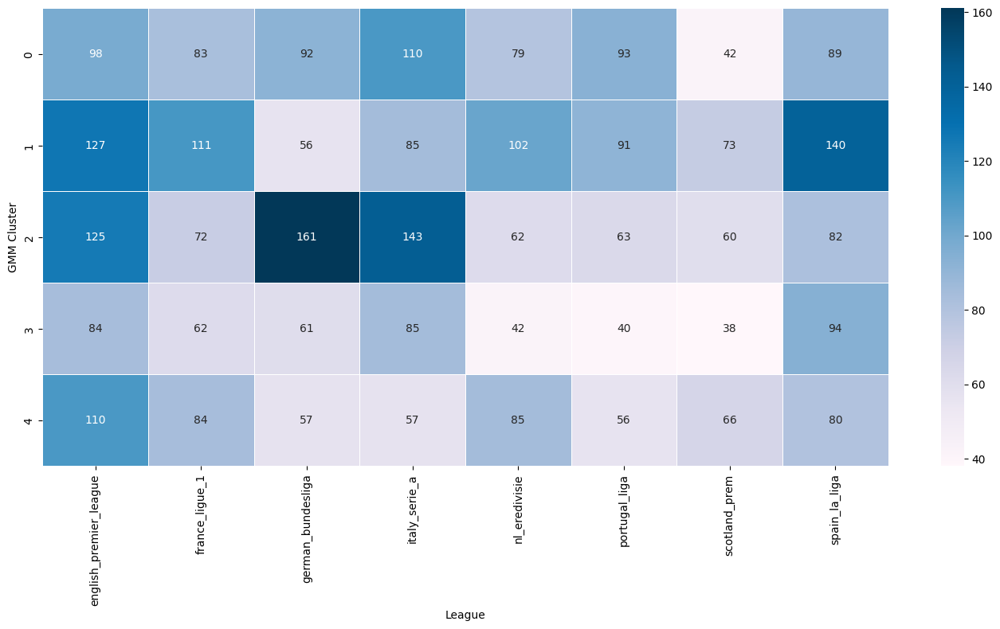


Purity Score (GMM): 0.184


In [ ]:
umap_model = umap.UMAP(n_components=10, random_state=22)
X_umap = umap_model.fit_transform(X_test_top_leagues)


n_components_list = [5]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_umap)

    sil = silhouette_score(X_umap, gmm_labels)
    ari = adjusted_rand_score(y_test_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_umap)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_umap)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_test_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.show()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.show()



purity = purity_score(y_test_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


n     Silhouette  ARI       
8     0.254       0.006     


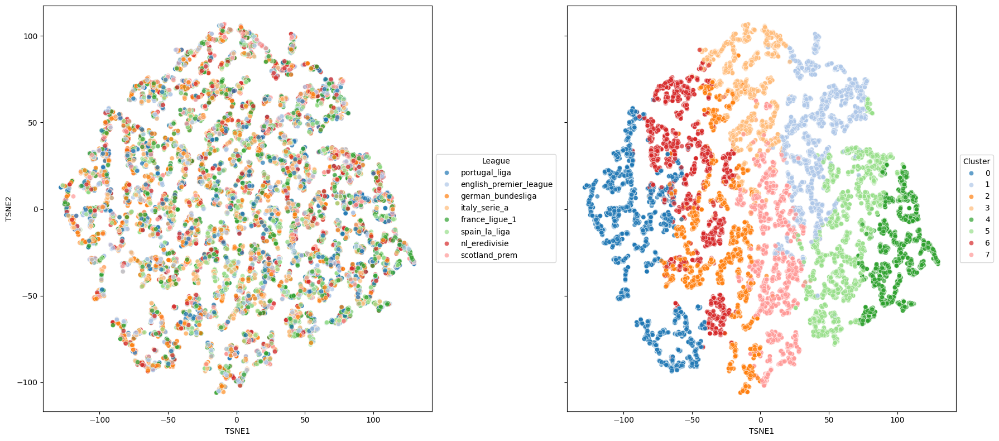

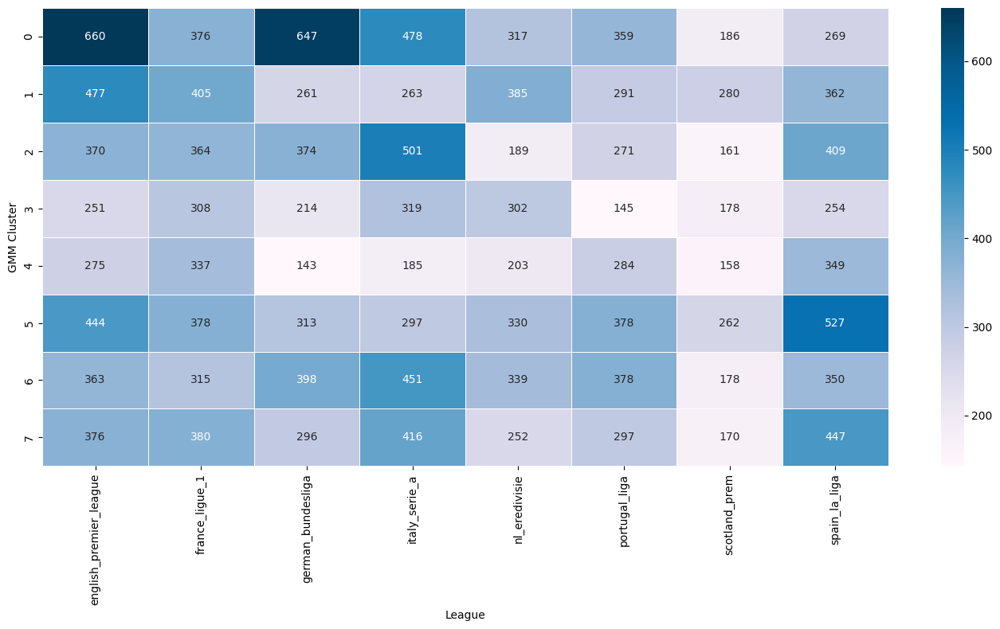


Purity Score (GMM): 0.179


In [ ]:
umap_model = umap.UMAP(n_components=10, random_state=22)
X_umap = umap_model.fit_transform(X_train_top_leagues)


n_components_list = [8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_umap)

    sil = silhouette_score(X_umap, gmm_labels)
    ari = adjusted_rand_score(y_train_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_umap)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_umap)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_train_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.show()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP UMAP GMM(n={best_n}) TRAIN.png")
plt.show()
plt.close()



purity = purity_score(y_train_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


n     Silhouette  ARI       
8     0.319       0.009     


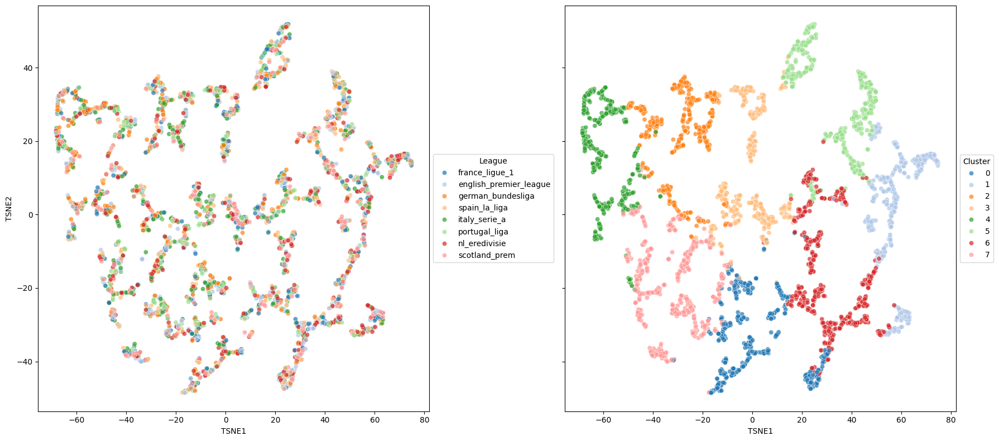

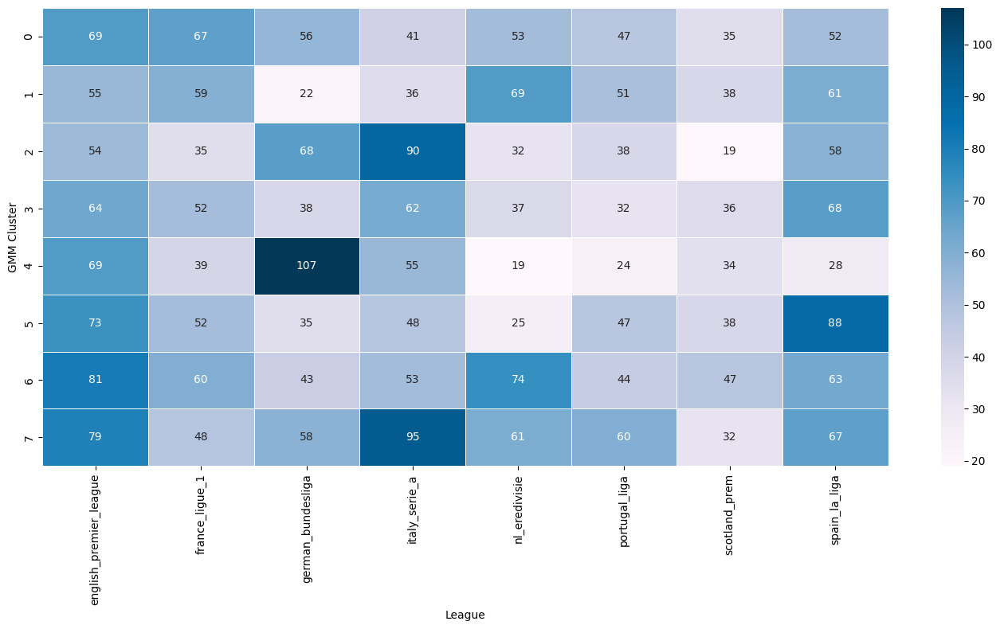


Purity Score (GMM): 0.200


In [ ]:
umap_model = umap.UMAP(n_components=10, random_state=22)
X_umap = umap_model.fit_transform(X_test_top_leagues)


n_components_list = [8]
results_gmm = []

for n in n_components_list:
    gmm = GaussianMixture(n_components=n, random_state=22)
    gmm_labels = gmm.fit_predict(X_umap)

    sil = silhouette_score(X_umap, gmm_labels)
    ari = adjusted_rand_score(y_test_top_leagues, gmm_labels)
    results_gmm.append((n, sil, ari))

# Metric Evaluation
print(f"{'n':<6}{'Silhouette':<12}{'ARI':<10}")
for n, sil, ari in results_gmm:
    print(f"{n:<6}{sil:<12.3f}{ari:<10.3f}")


best_n = max(results_gmm, key=lambda x: x[2])[0]
gmm_best = GaussianMixture(n_components=best_n, random_state=22)
gmm_labels_best = gmm_best.fit_predict(X_umap)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_umap)

df_vis = pd.DataFrame({
    'TSNE1': X_tsne[:, 0],
    'TSNE2': X_tsne[:, 1],
    'GMM_Label': gmm_labels_best,
    'League': y_test_top_leagues.values
})

# Plot
fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharex=True, sharey=True)

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='League', palette='tab20', alpha=0.7, ax=axes[0])
#axes[0].set_title('t-SNE Projection Colored by League')
axes[0].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='League')

sns.scatterplot(data=df_vis, x='TSNE1', y='TSNE2', hue='GMM_Label', palette='tab20', alpha=0.7, ax=axes[1])
#axes[1].set_title(f't-SNE Projection Colored by GMM Clusters (n={best_n})')
axes[1].legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/REDUCED UMAP GMM(n={best_n}) TEST.png")
plt.show()
plt.close()

# HEATMAP
crosstab_gmm = pd.crosstab(df_vis['GMM_Label'], df_vis['League'])

plt.figure(figsize=(14, 8))
sns.heatmap(crosstab_gmm, annot=True, fmt='d', cmap='PuBu', linewidths=0.5)
#plt.title(f'GMM Clusters vs Leagues (n_components={best_n})')
plt.xlabel('League')
plt.ylabel('GMM Cluster')

plt.tight_layout()
plt.savefig(f"/content/drive/MyDrive/THESIS/Code/plots/Clustering/HEATMAP UMAP GMM(n={best_n}) TEST.png")
plt.show()
plt.close()



purity = purity_score(y_test_top_leagues, gmm_labels_best)
print(f"\nPurity Score (GMM): {purity:.3f}")

###*League-wise Analysis*

League-wise Mean Attribute Values:
                        acceleration        age  aggression   agility  \
league                                                                  
austria_bundesliga         -0.043376  23.995612   -0.178101 -0.072766   
belgium_league             -0.021751  24.027579   -0.040768 -0.027794   
denmark_superliga          -0.022101  23.988530   -0.165698 -0.091815   
english_premier_league      0.084580  24.577320    0.130176  0.047300   
france_ligue_1              0.023003  24.346024    0.028864  0.012983   
german_bundesliga           0.055708  24.291932    0.061906  0.067656   
ireland_league             -0.341704  23.959193   -0.368021 -0.337654   
italy_serie_a               0.037938  25.585811    0.101658  0.014016   
nl_eredivisie               0.027346  23.213683   -0.102685 -0.010696   
norway_league              -0.020530  24.397629   -0.187792 -0.097421   
poland_league              -0.053703  25.151762   -0.204622 -0.083701   
portugal_liga   

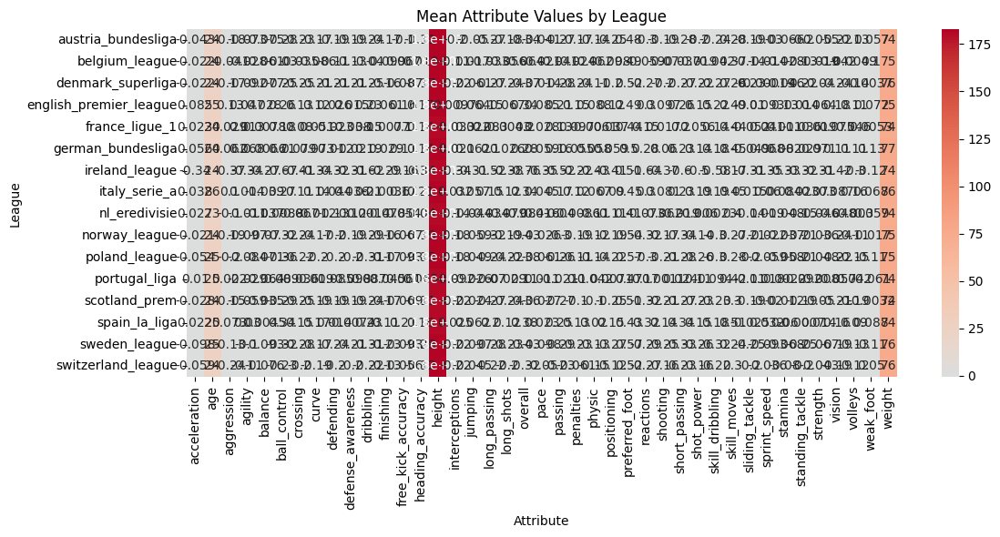

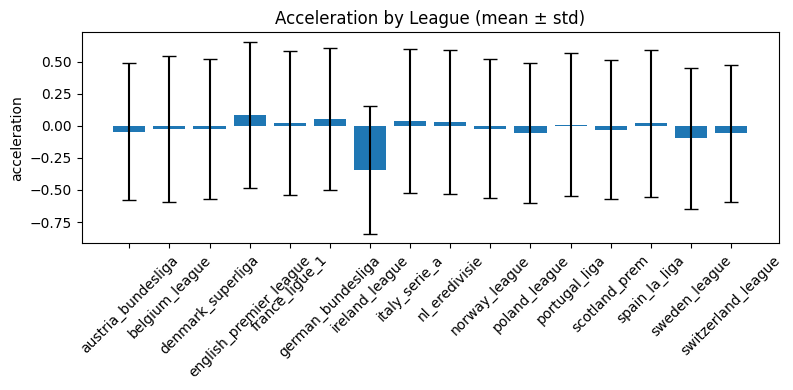

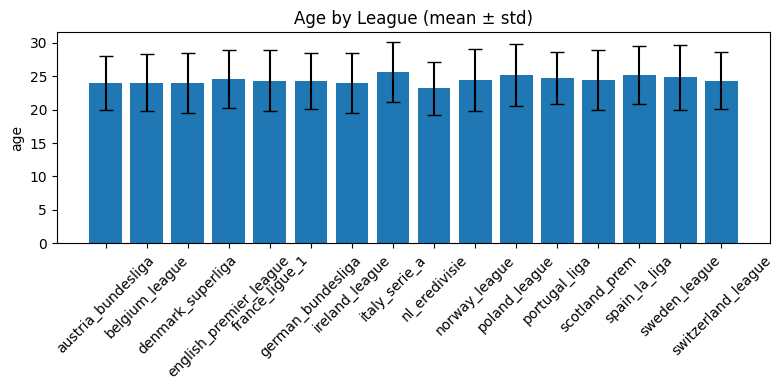

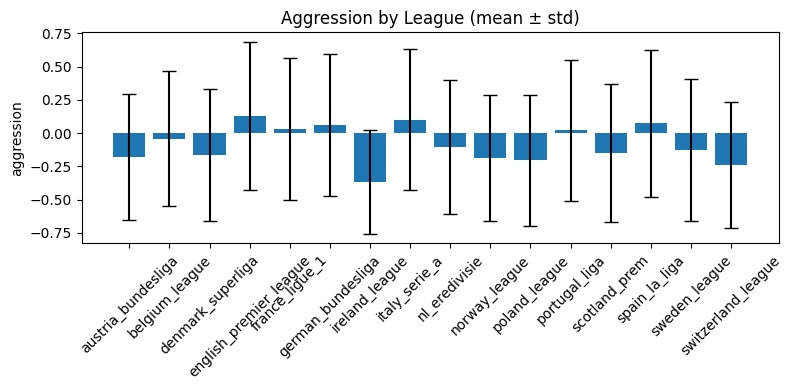

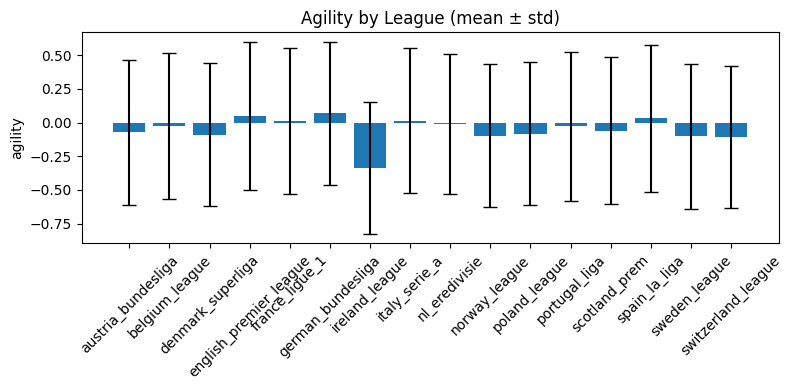

...

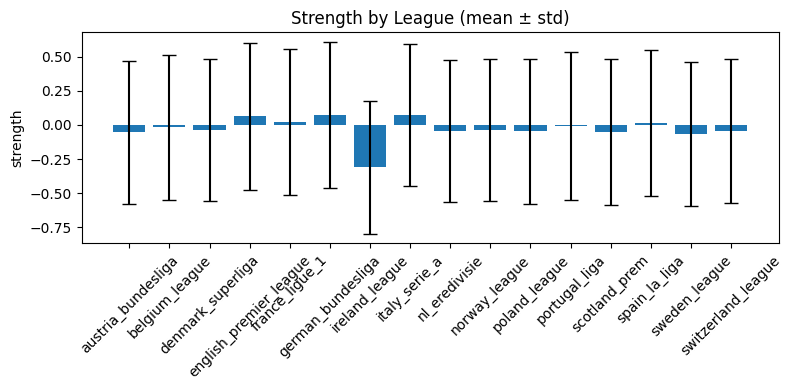

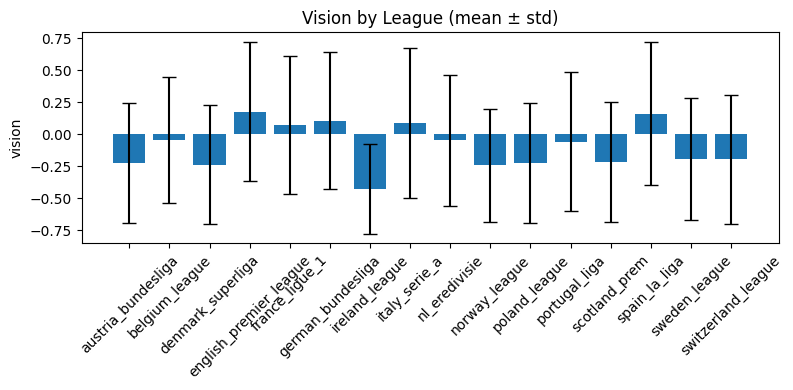

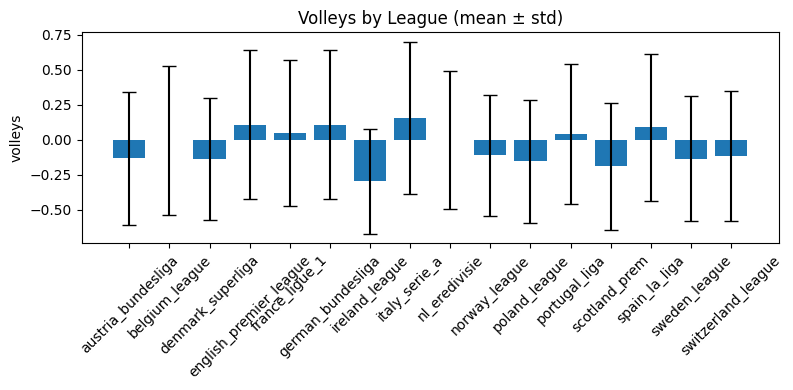

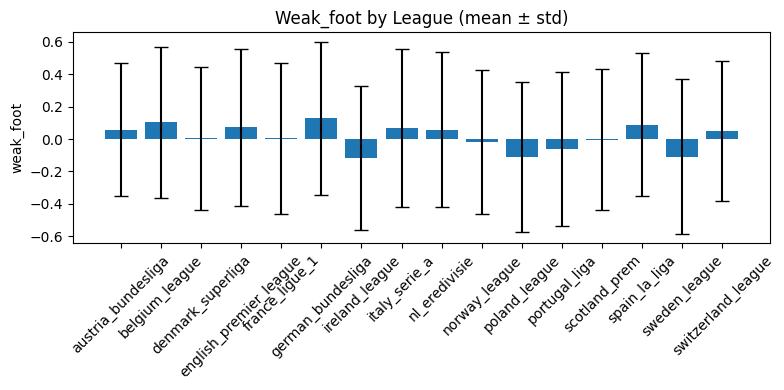

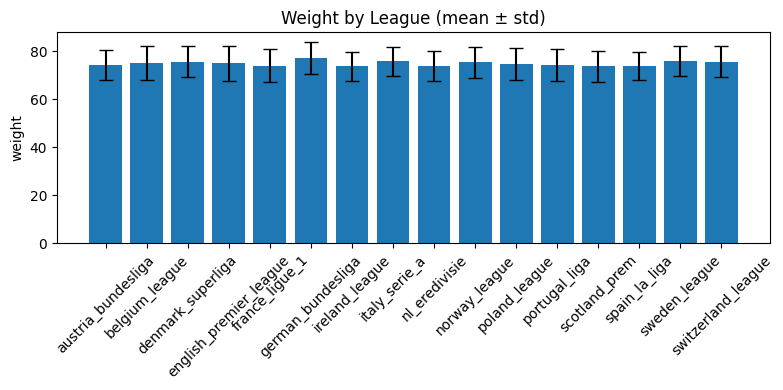

In [ ]:
attribute_cols = data.select_dtypes(include='number').columns.difference(['league'])

league_means = data.groupby('league')[attribute_cols].mean()
league_stds = data.groupby('league')[attribute_cols].std()

print("League-wise Mean Attribute Values:")
print(league_means)

print("\nLeague-wise Standard Deviations:")
print(league_stds)

# MEAN ATTRIBUTE VALUES BY LEAGUE
plt.figure(figsize=(12, 6))
sns.heatmap(league_means, annot=True, cmap='coolwarm', center=0)
plt.title("Mean Attribute Values by League")
plt.ylabel("League")
plt.xlabel("Attribute")
plt.tight_layout()
plt.show()


# PLOT x ATTRIBUTE & LEAGUE
for attr in attribute_cols:
    plt.figure(figsize=(8, 4))
    means = league_means[attr]
    stds = league_stds[attr]

    plt.bar(means.index, means.values, yerr=stds.values, capsize=5)
    plt.title(f"{attr.capitalize()} by League (mean ± std)")
    plt.ylabel(attr)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

                         overall        age      height     weight  \
cluster                                                              
english_premier_league  0.479183  24.840074  182.181985  74.970588   
france_ligue_1          0.338831  24.864078  181.233010  73.779126   
german_bundesliga       0.389246  25.264637  183.920375  78.105386   
italy_serie_a           0.431679  25.787500  183.285417  76.164583   
nl_eredivisie          -0.056865  24.135135  181.032432  73.278378   
portugal_liga           0.144465  25.291545  180.967930  73.956268   
scotland_prem          -0.281868  24.946237  181.293907  74.046595   
spain_la_liga           0.453123  25.931959  180.653608  73.696907   

                        preferred_foot  weak_foot  skill_moves      pace  \
cluster                                                                    
english_premier_league        0.444853   0.148558     0.571816  0.151654   
france_ligue_1                0.383495   0.029669     0.514889  0.09975

<ipython-input-52-7c7cba0dda20>:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=anova_df.head(top_n), x='F_value', y='Feature', palette='viridis')


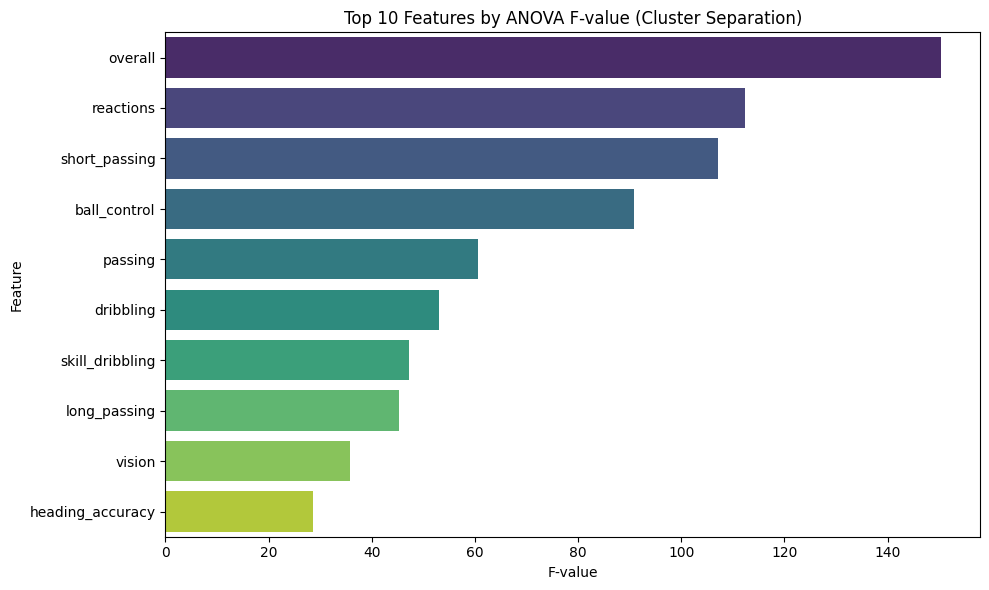

In [ ]:
# ANOVA ANALYSIS
gmm = GaussianMixture(n_components=6, random_state=22)
gmm_labels = gmm.fit_predict(X_test_top_leagues)

tsne = TSNE(n_components=2, perplexity=30, random_state=22)
X_tsne = tsne.fit_transform(X_test_top_leagues)

X_clustered = pd.DataFrame(X_test_top_leagues, columns=X_test_top_leagues.columns)
X_clustered['cluster'] = y_test_top_leagues
cluster_means = X_clustered.groupby('cluster').mean()
print(cluster_means)

# Run ANOVA F-test
f_vals, p_vals = f_classif(X_test_top_leagues, y_test_top_leagues)
top_n = 10

anova_df = pd.DataFrame({
    'Feature': X_test_top_leagues.columns,
    'F_value': f_vals,
    'p_value': p_vals
}).sort_values(by='F_value', ascending=False)

print(anova_df.head(10))  #top 10 features

mi_scores = mutual_info_classif(X_test_top_leagues, y_test_top_leagues, random_state=42)

mi_df = pd.DataFrame({
    'Feature': X_test_top_leagues.columns,
    'MI_score': mi_scores
}).sort_values(by='MI_score', ascending=False)

print(mi_df.head(top_n))

# Bar plot by F-value
plt.figure(figsize=(10, 6))
sns.barplot(data=anova_df.head(top_n), x='F_value', y='Feature', palette='viridis')
plt.title(f"Top {top_n} Features by ANOVA F-value (Cluster Separation)")
plt.xlabel("F-value")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()

Overall Silhouette Score: -0.038


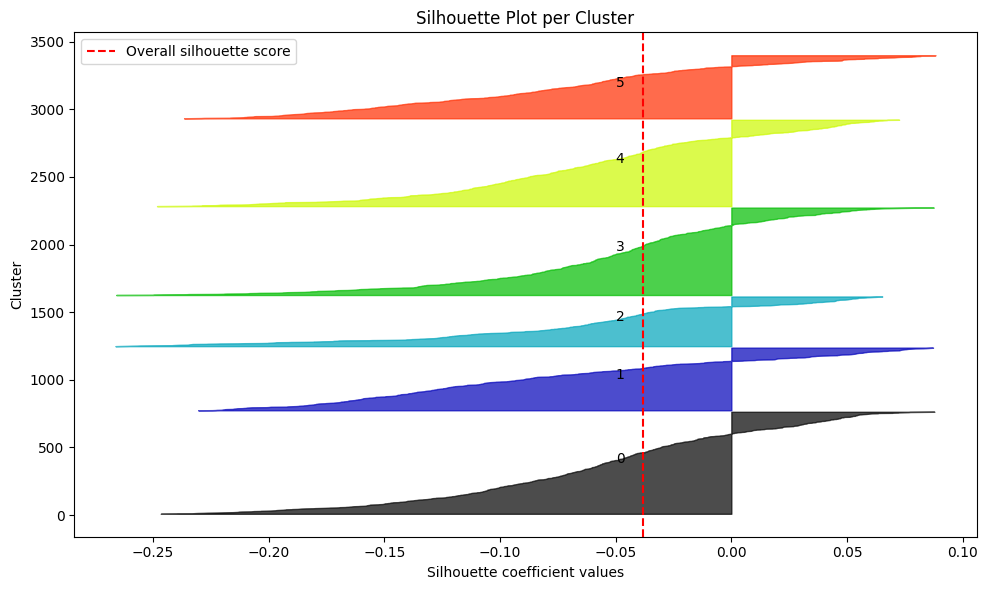

In [ ]:
gmm = GaussianMixture(n_components=6, random_state=22)
gmm_labels = gmm.fit_predict(X_test_top_leagues)


# SILHOUETTE X_TEST_TOP_LEAGUES
sample_silhouette_values = silhouette_samples(X_test_top_leagues, y_test_top_leagues)
overall_score = silhouette_score(X_test_top_leagues, gmm_labels)
print(f"Overall Silhouette Score: {overall_score:.3f}")

cluster_ids = np.unique(gmm_labels)
n_clusters = len(cluster_ids)

# Plot
fig, ax = plt.subplots(figsize=(10, 6))
y_lower = 10

for i in cluster_ids:
    ith_cluster_silhouette_values = sample_silhouette_values[gmm_labels == i]
    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7,
    )

    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10  # space between clusters

ax.axvline(x=overall_score, color="red", linestyle="--", label="Overall silhouette score")
ax.set_xlabel("Silhouette coefficient values")
ax.set_ylabel("Cluster")
ax.set_title("Silhouette Plot per Cluster")
ax.legend()
plt.tight_layout()
plt.show()